# Projet P5 OC Data Scientist: Segmentez des clients d'un site e-commerce

# 1. Problèmatique

Prise en compte des catégories de produit dans le jeu de données à 22 variables en entrée.

Analyse RFM sur un échantillon des données client (environ 28 %), sur une période de 3 mois, entre le 01/01/2018 et le 31/03/2018, afin de ne pas saturer les ressources système (mémoire et processeur) pour l'application de algorithmes non supervisés de clustering.

Analyse de la qualité de la segmentation RFM avec réduction de dimensions / visualisation t-SNE.

Entraînement des algorithmes de clustering non-supervisés (K-Means, DBSCAN, clustering hiérarchique) pour améliorer la segmentation clientèle:
- réduction de dimension / visualisation des clusters avec t-SNE
- détermination du meilleur modèle en analysant la qualité de clustering:
    - détermination du facteur de forme
    - calcul de la distance inter-clusters
    - homogénéité des clusters (taille, nombre)

Détermination de la stabilité temporelle du clustering sur la solution retenue en vue d'établir un contrat de maintenance.

Conclusion

# 2. Mise en place de l'environnement et importation des librairies

In [166]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import datetime as dt
import seaborn as sns
import squarify
import sklearn
import plotly.graph_objects as go
import plotly.express as px
import warnings
import scipy.cluster.hierarchy as shc

from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.decomposition import PCA
from sklearn import manifold
from sklearn.neighbors import NearestNeighbors
from matplotlib.colors import ListedColormap
from time import time
from datetime import datetime
from collections import Counter
from scipy.spatial.distance import euclidean
from dateutil.relativedelta import relativedelta

from math import radians, cos, sin, asin, sqrt

# Lbrairies pour le clustering
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, InterclusterDistance
from sklearn.metrics import silhouette_score, adjusted_rand_score
from sklearn.cluster import DBSCAN, AgglomerativeClustering

warnings.filterwarnings("ignore")

# Versions des librairies
print("Version librairie pandas: " + pd.__version__)
print("Version librairie numpy: " + np.__version__)
print("Version librairie matplotlib: " + matplotlib.__version__)
print("Version librairie seaborn: " + sns.__version__)
print("Version librairie sklearn: " + sklearn.__version__)

Version librairie pandas: 1.1.3
Version librairie numpy: 1.19.2
Version librairie matplotlib: 3.3.2
Version librairie seaborn: 0.11.0
Version librairie sklearn: 0.24.2


# 3 .Fonctions

In [2]:
# Fonction pour le calcul des scores par facteur RFM
def rfm_factor_score(rfm_table, R_col, F_col, M_col):
    rfm_table['R'] = pd.qcut(rfm_table[R_col],4,labels=[4,3,2,1])
    rfm_table['F'] = pd.qcut(rfm_table[F_col].rank(method='first'),4,labels=[1,2,3,4])
    rfm_table['M'] = pd.qcut(rfm_table[M_col],4,labels=[1,2,3,4])
    
    return rfm_table

In [3]:
# Fonction pour le regroupement des segments RFM dans la variable "grp_rfm_segment"
def rfm_regroup_segment(rfm_table, col_segment):
    
    for i in rfm_table.index:
        # Cas des meilleurs clients
        if rfm_table[col_segment][i] == '444':
            rfm_table.loc[i, 'grp_rfm_segment'] = 'Meilleurs clients'

         # Cas des clients fidèles    
        elif rfm_table[col_segment][i] in ['334', '342', '343', '344', '433', '434', '443']:
            rfm_table.loc[i, 'grp_rfm_segment'] = 'Clients fidèles'
            
        # Cas des clients potentiellement fidèles
        elif rfm_table[col_segment][i] in ['332', '333', '341', '412', '413', '414', '431',\
                                           '432', '441','442', '421', '422', '423', '424']:
            rfm_table.loc[i, 'grp_rfm_segment'] = 'Clients potentiellement fidèles'
            
        # Cas des nouveaux clients
        elif rfm_table[col_segment][i] == '411':
            rfm_table.loc[i, 'grp_rfm_segment'] = 'Nouveaux clients'
                
        # Cas des clients prometteurs    
        elif rfm_table[col_segment][i] in ['311', '312', '313', '331']:
            rfm_table.loc[i, 'grp_rfm_segment'] = 'Clients prometteurs' 
            
        # Cas des clients à surveiller    
        elif rfm_table[col_segment][i] in ['212', '213', '214', '231', '232', '233', '241', '314', '321',\
                                          '322', '323', '324']:
            rfm_table.loc[i, 'grp_rfm_segment'] = 'Clients à surveiller'
        
        # Cas des clients peu actifs
        elif rfm_table[col_segment][i] == '211':
            rfm_table.loc[i, 'grp_rfm_segment'] = 'Clients peu actifs'
                
        # Cas des clients à risque    
        elif rfm_table[col_segment][i] in ['112', '113', '114', '131', '132', '133', '142', '124', '123',\
                                          '122', '121', '224', '223', '222', '221']:
            rfm_table.loc[i, 'grp_rfm_segment'] = 'Clients à risque'
            
         # Cas des clients à ne pas perdre    
        elif rfm_table[col_segment][i] in ['134', '143', '144', '234', '242', '243', '244']:
            rfm_table.loc[i, 'grp_rfm_segment'] = 'Clients à ne pas perdre'
            
         # Cas des clients en sommeil
        elif rfm_table[col_segment][i] == '141':
            rfm_table.loc[i, 'grp_rfm_segment'] = 'Clients en sommeil'
    
        # Cas des clients perdus
        elif rfm_table[col_segment][i] == '111':
            rfm_table.loc[i, 'grp_rfm_segment'] = 'Clients perdus'
            
        else:
            rfm_table.loc[i, 'grp_rfm_segment'] = 'Segment inconnu'
        
    return rfm_table

In [4]:
# Fonction pour l'affichage des clients par segment RFM (nombre + pourcentage)
def affich_rfm_segments(df_in, col_segment):
    segments_counts = df_in[col_segment].value_counts().sort_values(ascending=True)

    fig, ax = plt.subplots()

    bars = ax.barh(range(len(segments_counts)),
                  segments_counts,
                  color='b')
    ax.set_frame_on(False)
    ax.tick_params(left=False,
                   bottom=False,
                   labelbottom=False)
    ax.set_yticks(range(len(segments_counts)))
    ax.set_yticklabels(segments_counts.index,  fontsize = 14)

    for i, bar in enumerate(bars):
        value = bar.get_width()
        if segments_counts.index[i] in ['Meilleurs clients', 'Clients fidèles']:
            bar.set_color('g')
        ax.text(value,
                bar.get_y() + bar.get_height()/2,
                '{:,} ({:.2f}%)'.format(int(value),
                                 float((value/segments_counts.sum())*100)),
                va='center',
                ha='left'
               )
sns.set(rc={'figure.figsize':(12,12)})
plt.show()

In [5]:
# Fonction pour autre affichage des segments RFM (squarify)
def affich_squarify_rfm_segments(df_in):
    df_in.columns = df_in.columns.droplevel()
    df_in.columns = ['recency_mean','frequency_mean','monerary_mean', 'count']
    
    # Définition des labels 
    labels = ["%s\n%d (nombre)\n%.2f %%" % (label) for label in zip(df_in.index, df_in['count'],
                                                            (df_in['count']/sum(df_in['count']))*100)]
    
    # Affichage des differentes zones
    fig = plt.gcf()
    ax = fig.add_subplot()
    fig.set_size_inches(16, 9)
    squarify.plot(sizes=df_in['count'], 
                        label=labels,
                        alpha=0.5)
    
    plt.title("Segments RFM globaux",fontsize=18,fontweight="bold")
    plt.axis('off')
    plt.show()
    
    return None

In [6]:
# Fonction pour calcul PCA et affichage du diagramme des éboulis des vecteurs propres
def calcul_pca(df_in, eboulis_affich, method_std):
    
    data_pca = df_in.values
    features = df_in.columns
    
    # Pipeline de pre-processing
    # Standardisation des données + calcul PCA
    pca = Pipeline([("preprocessor", method_std),
                   ("pca", PCA(svd_solver='full'))])
    pca.fit(data_pca)
    data_pca_projected = pca.transform(data_pca) 
        
    # Affichage du diagramme des éboulis et somme cumulée des variances des composantes de l'ACP
    if eboulis_affich == 'O':

        # Explained variance
        varexpl = pca.named_steps['pca'].explained_variance_ratio_*100

        # Plot of cumulated variance
        plt.figure(figsize=(11,4))
        plt.bar(np.arange(len(varexpl))+1, varexpl)

        cumSumVar = varexpl.cumsum()
        plt.plot(np.arange(len(varexpl))+1, cumSumVar,c="red",marker='o')
        plt.axhline(y=95, linestyle="--", 
                   color="green",
                   linewidth=1)

        limit = 95
        valid_idx = np.where(cumSumVar >= limit)[0]
        min_plans = valid_idx[cumSumVar[valid_idx].argmin()]+1
        plt.axvline(x=min_plans, linestyle="--", 
                   color="green",
                   linewidth=1)

        plt.xlabel("Rang de l'axe d'inertie")
        plt.xticks(np.arange(len(varexpl))+1)
        plt.ylabel("Pourcentage d'inertie")
        plt.title("{}% de la variance totale est expliquée"\
                  " par les {} premiers axes".format(limit,
                                            min_plans))
        plt.show(block=False)


    # Donnée pour affichage cercle des corrélations
    pcs = pca.named_steps['pca'].components_
    
    return data_pca, pcs, pca, features, data_pca_projected

In [7]:
# Fonction k-means pour déterminer le nombre de clusters et affichage du diagramme du coude
def calcul_nbre_cluster_kmeans(df_in, kmin, kmax, method):
    # Instantiate the clustering model and visualizer
    model = KMeans(init='k-means++')
    
    if method == 'distortion':
        visualizer = KElbowVisualizer(model, k=(kmin,kmax), metric=method)
    elif method == 'silhouette':
        visualizer = KElbowVisualizer(model, k=(kmin,kmax), metric=method, locate_elbow=False)

    # Entraînement des données
    visualizer.fit(df_in)        
    
    # Affichage du résultat
    visualizer.show()
    
    return None

In [8]:
# Fonction k-means pour calcul k-means
def calcul_kmeans(df_in, nbre_clusters):
    model_kmeans = KMeans(init = 'k-means++', n_clusters=nbre_clusters)
    cluster_kmeans = model_kmeans.fit(df_in)
    
    return model_kmeans, model_kmeans.labels_

In [9]:
# Fonction pour le calcul du coefficient de silhouette pour un k-means avec un nombre de clusters donné
def calcul_coef_silhouette_kmeans(df_in, clusterer):
    visualizer = SilhouetteVisualizer(clusterer)
    visualizer.fit(df_in)
    visualizer.show()

    return None

In [10]:
# Fonction pour le calcul de la distance inter-cluster pour un k-means avec un nombre de clusters donné
def calcul_distance_intercluster_kmeans(df_in, clusterer):
    visualizer = InterclusterDistance(clusterer)
    visualizer.fit(df_in)
    visualizer.show()

    return None

In [12]:
# Fonction pour affichage du cercle des corrélations à partir des différents plans factoriels (PCA)
def affich_cercle_corr(pcs, n_comp, pca, rang_fact, labels=None, label_rotation=0, lims=None):
    f1, f2 = rang_fact
    
    # Initialisation de la figure
    plt.figure(figsize=(9,9))
    
    if f2 < n_comp:
        
        # Détermination des limites du graphique
        if lims is not None :
            xmin, xmax, ymin, ymax = lims
        elif pcs.shape[1] < 30 :
            xmin, xmax, ymin, ymax = -1, 1, -1, 1
        else :
            xmin, xmax, ymin, ymax = min(pcs[f1,:]), max(pcs[f1,:]), min(pcs[f2,:]), max(pcs[f2,:])

        # Affichage des flèches
        # s'il y a plus de 30 flèches, on n'affiche pas le triangle à leur extrémité
        if pcs.shape[1] < 30 :
            plt.quiver(np.zeros(pcs.shape[1]), np.zeros(pcs.shape[1]),
            pcs[f1,:], pcs[f2,:], 
            angles='xy', scale_units='xy', scale=1, color="red", linewidths=2.5)

        else:
            lines = [[[0,0],[x,y]] for x,y in pcs[[d1,d2]].T]
            ax.add_collection(LineCollection(lines, axes=ax, alpha=.1, color='black'))
                        
        # Affichage des noms des variables  
        if labels is not None:
            for i,(x, y) in enumerate(pcs[[f1,f2]].T):
                if x >= xmin and x <= xmax and y >= ymin and y <= ymax :
                    plt.text(x, y, labels[i], fontsize='14', ha='center', va='center', rotation=label_rotation,
                             color="blue", alpha=0.5)
                        
        # Affichage du cercle
        circle = plt.Circle((0,0), 1, facecolor='none', edgecolor='b')
        plt.gca().add_artist(circle)

        # Définition des limites du graphique
        plt.xlim(xmin, xmax)
        plt.ylim(ymin, ymax)
        
        # Affichage des lignes horizontales et verticales
        plt.plot([-1, 1], [0, 0], color='grey', ls='--')
        plt.plot([0, 0], [-1, 1], color='grey', ls='--')

        # Nom des axes, avec le pourcentage d'inertie expliqué
        sns.set(font_scale=1)
        plt.xlabel('F{} ({}%)'.format(f1+1, round(100*pca.named_steps['pca'].explained_variance_ratio_[f1],1)))
        plt.ylabel('F{} ({}%)'.format(f2+1, round(100*pca.named_steps['pca'].explained_variance_ratio_[f2],1)))

        sns.set(font_scale=1.5)
        plt.title("Cercle des corrélations (F{} et F{})".format(f1+1, f2+1))
        plt.show(block=False)
        
    return None

In [13]:
# Fonction pour calcul classification T-SNE
def classif_tsne(df_in_std, nb_comp):
    
    # Instantiation du T-SNE
    tsne = manifold.TSNE(n_components=nb_comp,
                     perplexity=30,
                     n_iter=300,
                     n_jobs=-1,
                     init='pca',    
                     verbose=1
                    )

    # Application du T-SNE
    X_projected = tsne.fit_transform(df_in_std)
    
    return X_projected

In [14]:
# Fonction pour la représentation graphique des points par T-SNE
def proj_grade_tsne(tsne_proj, nbre_color):

    # Affichage des points en 2D
    plt.figure(figsize=(15,15))

    # Definition du titre
    plt.title("Visualisation t-SNE 2D\n")

    plot = sns.scatterplot(
                x="tsne-2d-axe 1", y="tsne-2d-axe 2",
                hue=tsne_proj.labels.tolist(),
                palette=sns.color_palette("hls", nbre_color),
                data=tsne_proj,
                legend="full",
                alpha=0.5)
    
    # Modification taille de la légende
    plt.setp(plot.get_legend().get_texts(), fontsize='8') 
        
    plt.show()
        
    
    return None

In [15]:
# Fonction pour la représentation graphique des points par T-SNE (sans affichage des labels)
def proj_grade_tsne_no_label(tsne_proj):

    # Affichage des points en 2D
    plt.figure(figsize=(15,15))

    # Definition du titre
    plt.title("Visualisation t-SNE 2D\n")

    plot = sns.scatterplot(
                x="tsne-2d-axe 1", y="tsne-2d-axe 2",
                alpha=0.3)
    
    plt.show()
        
    
    return None

In [16]:
# Fonction pour la représentation graphique 3D des points par T-SNE (mode non interactif avec labels)
def proj_grade_tsne_3d(tsne_proj, nbre_color):
    
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(111,projection='3d', facecolor='w')
    
    plt.grid()
   
    # Definition du titre
    plt.title("Visualisation t-SNE 3D\n")
    
    my_cmap = ListedColormap(sns.color_palette("hls",nbre_color)) 
            
    label_ids = np.unique(tsne_proj['labels'])
    nb_classes = len(np.unique(tsne_proj['labels']))
        
    for label_id in np.unique(tsne_proj['labels']):
            ax.scatter(tsne_proj[tsne_proj['labels'] == label_id]['tsne-3d-axe 1'],
                      tsne_proj[tsne_proj['labels'] == label_id]['tsne-3d-axe 2'],
                      tsne_proj[tsne_proj['labels'] == label_id]['tsne-3d-axe 3'],
                      alpha=0.5,
                      c=tsne_proj[tsne_proj['labels'] == label_id]['tsne-3d-axe 3'],
                      cmap=my_cmap, 
                      marker='o',
                      label=label_id)
                
    ax.set_xlabel('tsne-3d-axe 1')
    ax.set_ylabel('tsne-3d-axe 2')
    ax.set_zlabel('tsne-3d-axe 3')
    
    ax.legend(fontsize=12, facecolor='w', loc='best')
    
    plt.show()
 
    return None

In [17]:
# Fonction pour la représentation graphique 3D des points par T-SNE (mode non interactif - sans label)
def proj_grade_tsne_3d_no_label(tsne_proj):
    
    fig = plt.figure(figsize=(16,16))
    ax = fig.add_subplot(111,projection='3d', facecolor='w')
    
    plt.grid()
   
    # Definition du titre
    plt.title("Visualisation t-SNE 3D\n")
    
    ax.scatter(tsne_proj['tsne-2d-axe 1'],
               tsne_proj['tsne-2d-axe 2'],
               tsne_proj['tsne-2d-axe 3'],
               alpha=0.1, 
               marker='o')
                
    ax.set_xlabel('tsne-3d-axe 1')
    ax.set_ylabel('tsne-3d-axe 2')
    ax.set_zlabel('tsne-3d-axe 3')
    
    plt.show()
 
    return None

In [18]:
# Fonction pour la représentation graphique 3D des points par T-SNE (mode interactif)
def proj_grade_tsne_3d_interactif(tsne_proj):
    
    fig = go.Figure()
    
    grp_rfm_types = tsne_proj.labels.unique().tolist()

    # Affichage du graphe 3D selon les segments RFM 
    for grp_rfm in grp_rfm_types:
        val = tsne_proj.labels == grp_rfm
        fig.add_trace(go.Scatter3d(x=tsne_proj['tsne-3d-axe 1'][val], 
                                   y=tsne_proj['tsne-3d-axe 2'][val], 
                                   z=tsne_proj['tsne-3d-axe 3'][val], 
                                   name=grp_rfm, 
                                   mode="markers",
                                  ))
    
    # Modification de la taille et de l'opacité des marqueurs   
    fig.update_traces(marker=dict(size=3, 
                              opacity=0.5)) 
    
    # Modification de la taille de la figure
    fig.update_layout(
        width=900,
        height=900,
        margin=dict(
            l=0,
            r=0,
            b=0,
            t=0
        ))
    
    # Ajout des labels des axes et de la légende
    fig.update_layout(
        scene = dict(xaxis_title='tsne-3d-axe 1',
                    yaxis_title='tsne-3d-axe 2',
                    zaxis_title='tsne-3d-axe 3'),
                    legend_title_text='Clusters')

                   
    # Redimensionnement de la légende
    fig.update_layout(legend= {'itemsizing': 'constant'}) 
    
    fig.show()

    return None

In [19]:
# Fonction pour la représentation graphique 3D des points par T-SNE (mode interactif, sans label)
def proj_grade_tsne_3d_interactif_no_label(tsne_proj):
    
    fig = go.Figure()
    
    fig.add_trace(go.Scatter3d(x=tsne_proj['tsne-3d-axe 1'], 
                                   y=tsne_proj['tsne-3d-axe 2'], 
                                   z=tsne_proj['tsne-3d-axe 3'], 
                                   #name=grp_rfm, 
                                   mode="markers",
                                  ))
    
    # Modification de la taille et de l'opacité des marqueurs   
    fig.update_traces(marker=dict(size=3, 
                              opacity=0.5)) 
    
    # Modification de la taille de la figure
    fig.update_layout(
        width=900,
        height=900,
        margin=dict(
            l=0,
            r=0,
            b=0,
            t=0
        ))
    
    # Ajout des labels des axes et de la légende
    fig.update_layout(
        scene = dict(xaxis_title='tsne-3d-axe 1',
                    yaxis_title='tsne-3d-axe 2',
                    zaxis_title='tsne-3d-axe 3'))
                    #legend_title_text='Clusters') 
    
    fig.show()

    return None

In [20]:
# Fonction pour afficher les composantes métier des clusters dans un plot radar (librairie plotly)
def plot_radars(data, group):
     
    data = pd.DataFrame(data, 
                         index=data.index,
                         columns=data.columns).reset_index()
    
    # Affichage du plot radar
    fig = go.Figure()

    for k in data[group]:
        fig.add_trace(go.Scatterpolar(
            r=data[data[group]==k].iloc[:,1:].values.reshape(-1),
            theta=data.columns[1:],
            fill='toself',
            name='Cluster '+str(k)
        ))

    # Mise à jour des labels  de l'axe radial et affichage du titre et légende
    fig.update_layout(
        polar=dict(
        radialaxis=dict(
          visible=True
        )
        ),
        showlegend=True,
        title={
            'text': "Comparaison des moyennes par variable des clusters",
            'y':0.95,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
        title_font_color="blue",
        title_font_size=18)
    
     # Modification de la taille de la figure
    fig.update_layout(
        width=800,
        height=800)

    fig.show()

In [21]:
# Fonction pour clustering DBSCAN
def clustering_dbscan(df_in, min_samples, eps):
    db = DBSCAN(eps=eps, min_samples=min_samples).fit(df_in)
    labels = db.labels_

    # Nombre de clusters dans les labels, ignorant le bruit si présent
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise_ = list(labels).count(-1)

    print('Nombre estimé de clusters: %d' % n_clusters_)
    print('Nombre estimé de points de bruits: %d' % n_noise_)
    print("Coefficient silhouette: %0.3f"
      % silhouette_score(df_in, labels))
    
    return db, labels

In [22]:
# Fonction pour clustering hiérarchique (agglomerative clustering)
def clustering_hierarchical(df_in, nbre_clusters):
    
    # Initialisation du Agglomerative clustering
    clustering_model=AgglomerativeClustering(n_clusters = nbre_clusters, affinity = 'euclidean', linkage = 'ward')
    clustering_model.fit(df_in.values)
    
    # Prévision des clusters
    clustering_prediction=clustering_model.fit_predict(df_in)
    
    print("Coefficient silhouette: %0.3f"
      % silhouette_score(df_in, clustering_prediction, metric='euclidean'))
    
    return clustering_prediction

In [23]:
# Fonction pour la standardisation des données
# Passage de la méthode de standardisation
def std_data(df_in, method):

    # Renvoie un tableau numpy
    x = df_in.values

    scaler = method
    x_scaled = scaler.fit_transform(x)
    df_data_std = pd.DataFrame(x_scaled, columns=df_in.columns)
    
    return df_data_std

In [24]:
# Fonction pour calcul distance haversine
# Calcul de la distance entre les clients et le site Olist
def haversine_distance(lat1, lng1, lat2, lng2, degrees=True):
    
    # Rayon de la Terre en miles
    r = 3956 
  
    if degrees:
        lat1, lng1, lat2, lng2 = map(radians, [lat1, lng1, lat2, lng2])
    
    # Formule Haversine
    dlng = lng2 - lng1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlng/2)**2
    distance = 2 * r * asin(sqrt(a))  

    return distance

In [25]:
# Fonction pour l'échantillonnage du jeu de données
def constit_dataset(dpath, is_initial_period, beg_initial_period, duration_initial_period):
    
    start_time = time()
    print("Dataset creation in progress ...")
    
    # Root path
    root_path = dpath
    
    # Load datasets
    df_customers = pd.read_csv(root_path + "olist_customers_dataset.csv")
    df_geolocation = pd.read_csv(root_path + "olist_geolocation_dataset.csv")
    df_orders = pd.read_csv(root_path + "olist_orders_dataset.csv")
    df_items = pd.read_csv(root_path + "olist_order_items_dataset.csv")
    df_payments = pd.read_csv(root_path + "olist_order_payments_dataset.csv")
    df_reviews = pd.read_csv(root_path + "olist_order_reviews_dataset.csv")
    df_products = pd.read_csv(root_path + "olist_products_dataset.csv")
    df_products_categ = pd.read_csv(root_path + "product_category_name_translation.csv")
    
    # MERGE DATASETS
    # Merge of "products" et "product categories" tables
    df_products = pd.merge(df_products, df_products_categ,
                    how="left",
                    on="product_category_name")

    # List of variables to suppress between 2 merged tables
    del_features_list = ["product_category_name", "product_name_lenght", "product_description_lenght",
                         "product_photos_qty", "product_weight_g", "product_length_cm", "product_height_cm",
                         "product_width_cm"]
    df_products.drop(del_features_list, axis=1, inplace=True)

    # Rename "product_category_name_english" in "product_category_name" column
    df_products = df_products.rename(columns={"product_category_name_english":
                                    "product_category_name"})
    
    # Merge of "order items" and "orders" table
    df_items = pd.merge(df_items, df_orders,
                       how="left",
                       on="order_id")

    # List of variables to suppress between 2 merged tables
    del_features_list = ["seller_id", "shipping_limit_date", "order_approved_at", "order_delivered_carrier_date",
                         "order_estimated_delivery_date"]
    df_items.drop(del_features_list, axis=1, inplace=True)
    
    # Only order status = 'delivered'
    df_items = df_items[df_items["order_status"] == "delivered"]
    
    datetime_cols = ["order_purchase_timestamp", 
                     "order_delivered_customer_date"]
    for col in datetime_cols:
        df_items[col] = df_items[col].astype('datetime64[ns]')
        
    # Select orders on period
    start = datetime.strptime(beg_initial_period, '%d/%m/%y %H:%M:%S')
    print(start)
    if(is_initial_period == True):
        period = duration_initial_period
    else:
        period = 12+period
    stop=start + pd.DateOffset(months=period)
    print(stop)
    
    df_items = df_items[(df_items["order_purchase_timestamp"]>=start)
                        & (df_items["order_purchase_timestamp"]<stop)]
    
    # List of orders on period
    period_orders = df_items.order_id.unique()
    
    df_items = decoupe_var_datetime(df_items, 'order_purchase', 'order_purchase_timestamp')
    
    # Calculate other features on period
    df_payments = df_payments[df_payments["order_id"].isin(period_orders)]
    
    # Creation of 2 new variables by grouping "Payments" data table
    group_payments = df_payments.groupby(by="order_id").agg(
    {"payment_sequential": 'count',
     "payment_installments": 'sum'})

    # Merge of tables "Payments" and "Order items" tables
    df_items = pd.merge(df_items, group_payments,
                       how="left",
                       on="order_id")

    # Rename 2 variables
    df_items = df_items.rename(columns={
            "payment_sequential": "nb_payment_sequential",
            "payment_installments": "sum_payment_installments"})
    
    df_reviews = df_reviews[df_reviews["order_id"].isin(period_orders)]
    
    # New variable creation by grouping "Review" data table
    group_reviews = df_reviews.groupby("order_id").agg({
                                                    "review_score": "mean"})

    # Merge of tables "Review" and "Order items"
    df_items = pd.merge(df_items, group_reviews,
                       how="left",
                       on="order_id")
    
    # Merge of tables "Customers" and "Order items"
    df_items = pd.merge(df_items, df_customers,
                       how="left",
                       on="customer_id")
    
    # Merge of tables "Products" and "Order items"
    df_data_orders_customers = pd.merge(df_items, df_products,
               how="left",
               on="product_id")
    
    # Suppress duplicates values in dataset
    df_data_orders_customers = drop_doublons_df(df_data_orders_customers)
    
    # NaN PROCESSING
    # Numeric variables processing
    df_data_orders_customers_nan = traite_nan_num(df_data_orders_customers)
    
    # Datetime variables processing
    df_data_orders_customers_nan = traite_nan_datetime(df_data_orders_customers_nan)
    
    # Categorical variables processing
    df_data_orders_customers = traite_nan_object(df_data_orders_customers_nan)
    
    # FEATURE ENGINEERING
    # Création of varible "delivery_time_days" for each order
    df_data_orders_customers["delivery_time_days"] = (df_data_orders_customers.order_delivered_customer_date
                                                  - df_data_orders_customers.order_purchase_timestamp)\
                                                  .dt.round('1d').dt.days

    # Variable 'order_delivered_customer_date' suppression
    df_data_orders_customers.drop("order_delivered_customer_date", axis=1, inplace=True)
    
    # Create produt categories grouping by high level categories
    df_data_orders_customers['product_category'] = np.where((df_data_orders_customers['product_category_name'].str.contains("fashio|luggage")==True),
                                                        'fashion_clothing_accessories',
                                               np.where((df_data_orders_customers['product_category_name'].str.contains("health|beauty|perfum")==True),
                                                        'health_beauty',
                                               np.where((df_data_orders_customers['product_category_name'].str.contains("toy|baby|diaper")==True),
                                                         'toys_baby',
                                               np.where((df_data_orders_customers['product_category_name'].str.contains("book|cd|dvd|media")==True),
                                                         'books_cds_media',
                                               np.where((df_data_orders_customers['product_category_name'].str.contains("grocer|food|drink")==True), 
                                                         'groceries_food_drink',
                                               np.where((df_data_orders_customers['product_category_name'].str.contains("phon|compu|tablet|electro|consol")==True), 
                                                         'technology',
                                               np.where((df_data_orders_customers['product_category_name'].str.contains("home|furnitur|garden|bath|house|applianc")==True), 
                                                         'home_furniture',
                                               np.where((df_data_orders_customers['product_category_name'].str.contains("flow|gift|stuff")==True),
                                                         'flowers_gifts',
                                               np.where((df_data_orders_customers['product_category_name'].str.contains("sport")==True),
                                                         'sport', 'other')))))))))
    
    # Variable "product_category_name" suppression
    df_data_orders_customers.drop("product_category_name", axis=1, inplace=True)
    
    # Commandes client avec décomposition du nombre d'articles par catégorie de produit
    categories_customers = df_data_orders_customers.groupby(["customer_unique_id", "product_category"])\
                        .agg({"order_item_id": "count"}).unstack()


    # Suppression du niveau supérieur (niveau lignes de commande)
    categories_customers.columns = categories_customers.columns.droplevel(0)

    # Remplacement de valeurs NaN par la valeur 0
    categories_customers.fillna(0, inplace=True)

    # Calcul du nombre d'articles commandés par client et par catégorie de produit
    categories_customers["total_items"] = categories_customers.sum(axis=1)
    
    # Calcul du ratio du nombre de produits par catégorie sur le nombre de produits total acheté par le client
    for col in categories_customers.columns:
        if (col != "total_items"):
            categories_customers[col] = (categories_customers[col]/categories_customers["total_items"])

    categories_customers.reset_index(inplace=True)
    
    # Calcul du nombre moyen d'articles par commande pour chaque client
    products_per_order = df_data_orders_customers.groupby(["customer_unique_id", "order_id"])\
                                                        .agg({"order_item_id": "count"})
    products_per_order = products_per_order.groupby("customer_unique_id")\
                            .agg({"order_item_id": "mean"})
    
    # Calcul de la première et dernière date de commande pour chaque client
    order_delay = df_data_orders_customers.groupby("customer_unique_id")\
                    .agg({"order_purchase_timestamp": ["min","max"]})

    # Suppression du niveau date d'achat
    order_delay.columns = order_delay.columns.droplevel(0)

    # Calcul de la date de dernière commande, tous clients confondus
    max_date = df_data_orders_customers["order_purchase_timestamp"].max()
    print('Date dernier achat, tous clients confondus: ' + str(max_date))

    # Calcul du délai depuis le dernier achat
    order_delay["order_total_delay"] = [(y[1] - y[0]).round('1d').days if y[1] != y[0] 
                                        else (max_date - y[0]).round('1d').days 
                                        for x,y in order_delay.iterrows()]

    # Suppression des colonnes "min" et "max"
    order_delay.drop(["min", "max"], axis=1, inplace=True)
    
    # CREATION DATASET ORIENTE CLIENT
    # Regroupement des clients 
    df_data_orders_customers_ml = df_data_orders_customers.groupby("customer_unique_id")\
                                                            .agg({"order_id": "nunique",
                                                                  "price": "sum",
                                                                  "freight_value": "sum",
                                                                  "nb_payment_sequential": "mean",
                                                                  "review_score" : "mean",
                                                                  "sum_payment_installments": "mean", 
                                                                  "delivery_time_days": "mean",
                                                                  "order_purchase_year": lambda x:x.value_counts().index[0],
                                                                  "order_purchase_month": lambda x:x.value_counts().index[0],
                                                                  "order_purchase_hour": lambda x:x.value_counts().index[0]})

    # Renommage des colonnes
    df_data_orders_customers_ml = df_data_orders_customers_ml.rename(columns={"order_id": "nb_orders",
                            "price": "total_spend",
                            "freight_value": "total_freight",
                            "nb_payment_sequential": "mean_payment_sequential",
                            "sum_payment_installments": "mean_payment_installments",
                            "review_score": "mean_review_score",
                            "delivery_time_days": "mean_delivery_days",
                            "order_purchase_year": "favorite_purchase_year",
                            "order_purchase_month": "favorite_purchase_month",
                            "order_purchase_hour": "favorite_purchase_hour"})
    
    # Merge avec la décomposition des nombre d'articles par catégorie de produit
    df_data_orders_customers_ml = pd.merge(df_data_orders_customers_ml, categories_customers,
                                        how="left",
                                        on="customer_unique_id")
    
    # Merge avec le nombre moyen d'articles par commande pour chaque client
    df_data_orders_customers_ml = pd.merge(df_data_orders_customers_ml, products_per_order,
                                        how="left",
                                        on="customer_unique_id")\
                                        .rename(columns={"order_item_id": "mean_nb_items"})

    # Merge avec le nombre de jours écoulés entre la première et la dernière commande du client
    df_data_orders_customers_ml = pd.merge(df_data_orders_customers_ml, order_delay,
                how="left",
                on="customer_unique_id")
    
    # Calcul du délai moyen entre plusieurs achats
    df_data_orders_customers_ml["order_total_delay"] = df_data_orders_customers_ml["order_total_delay"] / df_data_orders_customers_ml["nb_orders"]
    df_data_orders_customers_ml = df_data_orders_customers_ml.rename(columns={"order_total_delay": "order_mean_delay"})
 
    # Calcul du ratio Frêt / total de la commande
    df_data_orders_customers_ml["freight_ratio"] = round(df_data_orders_customers_ml["total_freight"] /\
                                                     (df_data_orders_customers_ml["total_spend"] +\
                                                      df_data_orders_customers_ml["total_freight"]),2)
    
    # Calcul du prix moyen par commande du client
    df_data_orders_customers_ml["mean_price_order"] = round(df_data_orders_customers_ml["total_spend"] /\
                                                        df_data_orders_customers_ml["nb_orders"],2)
    
    # Calcul du prix moyen par commande du client
    df_data_orders_customers_ml["mean_price_order"] = round(df_data_orders_customers_ml["total_spend"] /\
                                                        df_data_orders_customers_ml["nb_orders"],2)

    # Intégration des frais de livraison dans le total dépensé sur une commande
    df_data_orders_customers_ml["total_spend"] = (df_data_orders_customers_ml["total_spend"] + df_data_orders_customers_ml["total_freight"])

    # Suppression de la variable "total_freight"
    df_data_orders_customers_ml.drop("total_freight", axis=1, inplace=True)
    
    # suppression de la colonne "customer_id" dans la table Client
    df_customers.drop("customer_id", axis=1, inplace=True)

    # Sélection des valeurs les plus fréquentes
    df_customers_info = df_customers.groupby("customer_unique_id").agg(lambda x:x.value_counts().index[0])

    # Merge des informations de localisation dans la table orientée client
    df_data_orders_customers_ml = pd.merge(df_data_orders_customers_ml, df_customers_info,
                                       how="left",
                                       on="customer_unique_id")
    
    # Remplacement du sigle des états brésiliens par des noms
    wiki_url = "https://en.wikipedia.org/wiki/Federative_units_of_Brazil"
    states_table = pd.read_html(wiki_url)[1].set_index("Code")
    
    # Merge de la table orientée client avec avec les noms des états brésiliens
    df_data_orders_customers_ml = pd.merge(df_data_orders_customers_ml.reset_index(), states_table[["Flag and name"]],
                                        how="left",
                                        left_on="customer_state",
                                        right_on="Code")

    # Suppression de la colonne "customer_date"
    df_data_orders_customers_ml.drop("customer_state", axis=1, inplace=True)

    # Renommage de la colonne "Flag and name"
    df_data_orders_customers_ml = df_data_orders_customers_ml.rename(columns={"Flag and name": "customer_state"})

    # Calcul de la moyenne des latitudes et longitudes de l'état
    state_location = df_geolocation.groupby("geolocation_state").mean()

    # Merge des tables des états et de localisation
    state_location = pd.merge(states_table[["Flag and name"]].reset_index(), 
                          state_location, 
                          right_on="geolocation_state", 
                          left_on="Code", 
                          how="left")

    # Sélection de variables
    state_location = state_location[["Flag and name", "geolocation_lat", "geolocation_lng"]]

    # Localisation géographique du siège Olist
    olist_lat = -25.43045
    olist_lon = -49.29207
    
    # Appel de la fonction pour calcul de la distance Harversine between entre le centre de l'état du client et le siége Olist
    state_location['harvesine_distance'] = [haversine_distance(olist_lat, olist_lon, x, y) 
                                              for x, y in zip(state_location.geolocation_lat, 
                                              state_location.geolocation_lng)]
    
    # Merge de la table orientée client et de la table localisation avec distance harversine
    df_data_orders_customers_ml = pd.merge(df_data_orders_customers_ml, state_location[["Flag and name", "harvesine_distance"]],
                                             how="left",
                                             left_on="customer_state",
                                             right_on="Flag and name")
    
    # Suppression de l'index et régénération
    df_data_orders_customers_ml.drop("index", axis=1, inplace=True)
    
    # TRAITEMENT OUTLIERS
    # Traitement de valeurs numériques
    df_data_orders_customers_ml = traite_outliers_num(df_data_orders_customers_ml)
    
    # Appel de la fonction pour détecter les valeurs atypiques par la méthode inter-quartiles
    # pour les variables "total_spend", "mean_delivery_days", "mean_price_order"
    liste_col = ['total_spend', 'mean_delivery_days', 'mean_price_order']

    # Appel de la fonction pour détecter les valeurs atypiques par méthode inter-quartiles
    valatyp_to_drop = detect_outliers_iqr(df_data_orders_customers_ml, 1, liste_col)

    print('nombre de lignes à supprimer: ' + str(len(valatyp_to_drop)))
    
    df_data_orders_customers_ml.drop(valatyp_to_drop, inplace=True)
    print_proportion_nan(df_data_orders_customers_ml)
    
    # Suppression des variables "total_spend", "total_items", "favorite_purchase_year" suite analyse multivariée
    df_data_orders_customers_ml.drop(['total_spend', 'total_items', 
                                      'favorite_purchase_year'], axis=1, inplace=True)
    
    df_data_orders_customers_ml.reset_index(drop=True, inplace=True)
    
    end_time = time()
    print("Execution time for dataset creation and feature engineering : {:.2f}s".format(end_time - start_time))
    
    return df_data_orders_customers_ml

In [160]:
# Fonction pour déterminer la stabilité temporelle du k-means sur 3 mois glissants par pas de 1 mois sur 5 mois
def stabilite_tempo_kmeans(k, data_init, init_labels, dpath, is_initial_period, 
                           date_deb, duree_periode):
    sil_score = []
    
    # Initialisation du tableau des résultats du score de silhouette avec le score initial
    sil_score.append([0,0.4109])
    
    for p in np.arange(1,6,1):
    # Create dataset for period
    
        print('Création dataset pour pas: ' + str(p) + ' - décalage de ' 
              + str(p) + ' mois par rapport à la période initiale')
        print('--------------------------------------------------------------------------')
        
        date_format = '%d/%m/%y %H:%M:%S'
        dtobj = datetime.strptime(date_deb, date_format)
        future_date = dtobj + relativedelta(months=p)
        future_date_str = future_date.strftime(date_format)
    
        data_periode = constit_dataset(dpath, is_initial_period, future_date_str, duree_periode)
    
        # Préparation des données
        list_var_num = ['nb_orders',
                         'mean_payment_sequential',
                         'mean_review_score',
                         'mean_payment_installments',
                         'mean_delivery_days',
                         'favorite_purchase_month',
                         'favorite_purchase_hour',
                         'books_cds_media',
                         'fashion_clothing_accessories',
                         'flowers_gifts',
                         'groceries_food_drink',
                         'health_beauty',
                         'home_furniture',
                         'other',
                         'sport',
                         'technology',
                         'toys_baby',
                         'mean_nb_items',
                         'order_mean_delay',
                         'freight_ratio',
                         'mean_price_order',
                         'harvesine_distance']

        data_periode = data_periode[list_var_num]
        
        # Standardisation des données
        data_periode_scaled = std_data(data_periode,MinMaxScaler())
        
        
        # K-Means
        clusterer, labels = calcul_kmeans(data_periode_scaled,k)
        
        # Calcul du silhouette score
        silhouette_avg = silhouette_score(data_periode_scaled, labels)
        sil_score.append([p,silhouette_avg])
        print("Pour K (nbre clusters) =", k,"le score moyen de silhouette est de :", silhouette_avg)
        
    return sil_score 

In [28]:
# Fonction pour découper une variable de type datetime en
# Création variables:
# - Année: variable prefix_col_year
# - Numéro du mois: variable prefix_col_month
# - Numéro de jour dans la semaine: variable prefix_col_dayofweek
# - Heure: variable prefix_col_hour
# - Jour de la semaine: variable prefix_col_day
# - Mois: variable prefix_col_mon
def decoupe_var_datetime(df_in, prefix_col, col_datetime):
    df_in[prefix_col+'_year'] = df_in[col_datetime].apply(lambda x: x.year)
    df_in[prefix_col+'_month'] = df_in[col_datetime].apply(lambda x: x.month)
    df_in[prefix_col+'_dayofweek'] = df_in[col_datetime].apply(lambda x: x.dayofweek)
    df_in[prefix_col+'_hour'] = df_in[col_datetime].apply(lambda x: x.hour)
    df_in[prefix_col+'_day'] = df_in[prefix_col+'_dayofweek'].map({0:'Mon',1:'Tue',2:'Wed',3:'Thu',4:'Fri',5:'Sat',6:'Sun'})
    df_in[prefix_col+'_mon'] = df_in[col_datetime].apply(lambda x: x.month).map({1:'Jan',2:'Feb',3:'Mar',
                                                                                 4:'Apr',5:'May',6:'Jun',
                                                                                 7:'Jul',8:'Aug',9:'Sep',
                                                                                 10:'Oct',11:'Nov',12:'Dec'})
    return df_in

In [29]:
# Fonction pour supprimer les doublons de lignes dans une dataframe
def drop_doublons_df(df_in):
    
    # Création d'une variable indiquant la présence de lignes dupliquées dans la dataframe
    nbre_lignes_dupliq_av = df_in[df_in.duplicated(keep=False)] 
    
    print("Liste des lignes dupliquées pour chaque colonne de la dataframe :")
    print(nbre_lignes_dupliq_av)
    
    # Suppression des valeurs dupliquées
    df_in = df_in.drop_duplicates(keep=False)

    return df_in

In [30]:
# Fonction qui renvoie la proportion de NaN sur l'ensemble du dataset
def print_proportion_nan(df_in):
    print('Proportion de NaN : {} %, Taille du jeu de données : {}\n'
        .format(round((df_in.isna().sum().sum()/(df_in.shape[0]*df_in.shape[1]))*100,2),
        df_in.shape))
    return None

In [31]:
# Fonction pour le traitement de valeurs NaN pour les valeurs numériques
def traite_nan_num(df_in):
    # Imputation des valeurs NaN avec la valeur 1 pour la variable "nb_payment_sequential"
    print('------ Imputation valeur 1 si présence valeurs NaN pour variable "nb_payment_sequential" ------')
    df_in[['nb_payment_sequential']] = df_in[['nb_payment_sequential']].fillna(1)
    
    print('------ Dataset suite imputation valeur 1 si présence valeurs NaN pour variable "nb_payment_sequential" ------')
    print_proportion_nan(df_in)
   
    # Imputation des valeurs NaN avec la valeur 1 pour la variable "sum_payment_installments"
    print('------ Imputation valeur 1 si présence valeurs NaN pour variable "sum_payment_installments" ------')
    df_in[['sum_payment_installments']] = df_in[['sum_payment_installments']].fillna(1)
    
    print('------ Dataset suite imputation valeur 1 si présence valeurs NaN pour variable "sum_payment_installments" ------')
    print_proportion_nan(df_in)

    return df_in

In [32]:
# Fonction pour le traitement de valeurs NaN pour les valeurs datetime
def traite_nan_datetime(df_in):
    # Suppression des valeurs NaN pour la variable "order_delivered_customer_date"
    print('------ Suppression des valeurs NaN pour variable "order_delivered_customer_date" ------')
    df_in.dropna(subset=['order_delivered_customer_date'], axis=0, inplace=True)  
    
    print('------ Dataset suite suppression valeurs NaN pour variable "order_delivered_customer_date" ------')
    print_proportion_nan(df_in)      
    
    return df_in

In [33]:
# Fonction pour le traitement de valeurs NaN pour les valeurs qualitatives
def traite_nan_object(df_in):
    # Imputation des valeurs NaN avec la valeur 'other' pour la variable "product_category_name"
    print('------ Imputation valeur "other" si présence valeurs NaN pour variable "product_category_name" ------')
    df_in[['product_category_name']] = df_in[['product_category_name']].fillna('other')  
    
    print('------ Dataset suite imputation valeur 1 si présence valeurs NaN pour variable "product_category_name" ------')
    print_proportion_nan(df_in)      
    
    return df_in

In [34]:
# Fonction pour traiter les valeurs aberrantes pour les variables numériques
def traite_outliers_num(df_in):
    print('----- Remplacement des valeurs 0 par la valeur 1 pour la variable "mean_payment_installments" ------')
    df_in['mean_payment_installments'].replace({0: 1}, inplace=True)
          
    print('------ Dataset suite traitement outliers pour variable "mean_payment_installments" ------')
    print_proportion_nan(df_in)            
    
    return df_in

In [35]:
# Fonction pour la détection des valeurs atypiques par la méthode des inter-quartiles
def detect_outliers_iqr(df_in, n, var):
    
    outlier_indices = []

    # Boucle sur la liste des colonnes
    for col in var:
        # 1er quartile (25%)
        Q1 = np.percentile(df_in[col], 25)
        # 3ème quartile (75%)
        Q3 = np.percentile(df_in[col], 75)
        # Interquartile range (IQR)
        IQR = Q3 - Q1

        # outlier step
        outlier_step = 8 * IQR

        # Traitement de valeurs atypiques
        outlier_list_col = df_in[(df_in[col] < Q1 - outlier_step) | (df_in[col] > Q3 + outlier_step)].index

        # Liste des indices des valeurs atypiques
        outlier_indices.extend(outlier_list_col)

    # select observations containing more than 1 outlier
    outlier_indices = Counter(outlier_indices)        
  

    return outlier_indices

# 4. Chargement des données et échantillonnage des données

Prise en compte d'unéchantillon des données client (environ 22 %), sur une période de 3 mois, entre le 01/01/2018 et le 31/03/2018, afin de ne pas saturer les ressources système (mémoire et processeur) pour l'application de algorithmes non supervisés de clustering.

In [36]:
# Appel de la fonction pour la constitution du dataset d'origine
# Suppression de la variable "product_category_name"
df_ml_data_customer = constit_dataset('./Input/', True, '01/01/18 00:00:00', 3)

Dataset creation in progress ...
2018-01-01 00:00:00
2018-04-01 00:00:00
Liste des lignes dupliquées pour chaque colonne de la dataframe :
Empty DataFrame
Columns: [order_id, order_item_id, product_id, price, freight_value, customer_id, order_status, order_purchase_timestamp, order_delivered_customer_date, order_purchase_year, order_purchase_month, order_purchase_dayofweek, order_purchase_hour, order_purchase_day, order_purchase_mon, nb_payment_sequential, sum_payment_installments, review_score, customer_unique_id, customer_zip_code_prefix, customer_city, customer_state, product_category_name]
Index: []

[0 rows x 23 columns]
------ Imputation valeur 1 si présence valeurs NaN pour variable "nb_payment_sequential" ------
------ Dataset suite imputation valeur 1 si présence valeurs NaN pour variable "nb_payment_sequential" ------
Proportion de NaN : 0.08 %, Taille du jeu de données : (23572, 23)

------ Imputation valeur 1 si présence valeurs NaN pour variable "sum_payment_installments" 

In [37]:
df_ml_data_customer

,customer_unique_id,nb_orders,mean_payment_sequential,mean_review_score,mean_payment_installments,mean_delivery_days,favorite_purchase_month,favorite_purchase_hour,books_cds_media,fashion_clothing_accessories,...,toys_baby,mean_nb_items,order_mean_delay,freight_ratio,mean_price_order,customer_zip_code_prefix,customer_city,customer_state,Flag and name,harvesine_distance
0,00053a61a98854899e70ed204dd4bafe,1,1.0,1.0,3.0,16.0,2,11,0.0,0.0,...,0.0,2.0,32.0,0.09,382.00,80410,curitiba,Paraná,Paraná,108.557249
1,0005ef4cd20d2893f0d9fbd94d3c0d97,1,1.0,1.0,4.0,54.0,3,15,0.0,0.0,...,0.0,1.0,19.0,0.19,104.90,65060,sao luis,Maranhão,Maranhão,1522.737226
2,00090324bbad0e9342388303bb71ba0a,1,1.0,5.0,3.0,16.0,3,14,0.0,0.0,...,0.0,1.0,7.0,0.22,49.95,13054,campinas,São Paulo,São Paulo,209.713834
3,000d460961d6dbfa3ec6c9f5805769e1,1,1.0,5.0,1.0,4.0,1,22,0.0,0.0,...,0.0,1.0,83.0,0.21,28.90,1206,sao paulo,São Paulo,São Paulo,209.713834
4,0010fb34b966d44409382af9e8fd5b77,1,1.0,4.0,6.0,23.0,3,17,0.0,0.0,...,0.0,1.0,26.0,0.19,49.95,4321,sao paulo,São Paulo,São Paulo,209.713834
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20037,ffe0c10afc687bcf34a0451f2b87dd9b,1,1.0,1.0,1.0,10.0,2,21,0.0,0.0,...,0.0,1.0,51.0,0.17,179.00,8260,sao paulo,São Paulo,São Paulo,209.713834
20038,ffe4d6bcc48632f0bb1bedf53702cc4b,1,1.0,5.0,3.0,7.0,3,17,0.0,0.0,...,0.0,1.0,24.0,0.18,70.00,31270,belo horizonte,Minas Gerais,Minas Gerais,493.836401
20039,ffe6efca3c7e6a06bad0a6a883280a93,1,1.0,4.0,2.0,14.0,1,11,0.0,0.0,...,0.0,1.0,67.0,0.06,213.90,11702,praia grande,São Paulo,São Paulo,209.713834
20040,ffe9e41fbd14db4a7361347c56af5447,1,1.0,5.0,2.0,17.0,2,12,0.0,0.0,...,0.0,1.0,48.0,0.10,199.00,29101,vila velha,Espírito Santo,Espírito Santo,669.215559


# 5. Analyse RFM

RFM signifie **R**ecency, **F**requency et **M**onetary. 

L'analyse RFM aide l'entreprise à comprendre les caractéristiques du client en fonction de ses transactions historiques. Pour extraire des informations et des caractéristiques de leur comportement d'achat, il faut analyser le facteur RFM. 

Ensuite, le facteur RFM pour chaque client est classé en tant que segment RFM pour les campagnes marketing ciblées et la somme des facteurs RFM constitue le score RFM. Voici la liste des termes dans RFM:
- **Recency**: ce facteur évalue depuis combien de temps un client a effectué un achat, à partir d'une date donnée (soit la dernière date de commande, tous clients confondus, soit la dernière date de commande du client). Dans notre cas, cela correspond à la variable **"order_mean_delay"**, exprimée en délai moyen entre plusieurs achats par client.


- **Frequency**: ce facteur évalue à quelle fréquence un client effectue un achat. Dans notre cas, cela correspond à la variable **"nb_orders"** (nombre de commandes du client).


- **Monetary**: ce facteur évalue combien d'argent un client dépense en achats. Dans notre cas, cela correspond à la variable **"mean_price_order"** (montant moyen des achats du client).

In [38]:
df_ml_data_customer.describe()

,nb_orders,mean_payment_sequential,mean_review_score,mean_payment_installments,mean_delivery_days,favorite_purchase_month,favorite_purchase_hour,books_cds_media,fashion_clothing_accessories,flowers_gifts,...,other,sport,technology,toys_baby,mean_nb_items,order_mean_delay,freight_ratio,mean_price_order,customer_zip_code_prefix,harvesine_distance
count,20042.000000,20042.000000,20042.000000,20042.000000,20042.000000,20042.000000,20042.000000,20042.000000,20042.000000,20042.000000,...,20042.000000,20042.000000,20042.000000,20042.000000,20042.000000,20042.000000,20042.000000,20042.000000,20042.000000,20042.000000
mean,1.020407,1.038719,3.925518,2.749398,15.605157,1.998803,14.739796,0.008424,0.030123,0.084930,...,0.143766,0.086339,0.196616,0.051034,1.135688,44.037924,0.210523,121.139250,35602.075891,433.629037
std,0.149288,0.298831,1.440739,2.531583,10.943871,0.826980,5.256364,0.090994,0.170304,0.278045,...,0.349591,0.280241,0.396832,0.218888,0.501925,25.950180,0.124230,126.490568,30030.559350,372.318851
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.010000,2.990000,1005.000000,108.557249
25%,1.000000,1.000000,3.000000,1.000000,8.000000,1.000000,11.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,22.000000,0.120000,44.990000,11611.500000,209.713834
50%,1.000000,1.000000,5.000000,2.000000,13.000000,2.000000,15.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,43.000000,0.180000,85.085000,25525.000000,209.713834
75%,1.000000,1.000000,5.000000,4.000000,20.000000,3.000000,19.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,67.000000,0.280000,149.000000,60176.500000,493.836401
max,5.000000,15.000000,5.000000,24.000000,110.000000,3.000000,23.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,14.000000,90.000000,0.810000,989.000000,99965.000000,2087.340387


On se rend compte qu'il y a des acheteurs ponctuels avec une recency (variable "order_mean_delay") à 0.

In [39]:
# Suppression des acheteurs ponctuels
df_ml_data_customer_filtre = df_ml_data_customer[df_ml_data_customer['order_mean_delay'] > 0]
df_ml_data_customer_filtre

,customer_unique_id,nb_orders,mean_payment_sequential,mean_review_score,mean_payment_installments,mean_delivery_days,favorite_purchase_month,favorite_purchase_hour,books_cds_media,fashion_clothing_accessories,...,toys_baby,mean_nb_items,order_mean_delay,freight_ratio,mean_price_order,customer_zip_code_prefix,customer_city,customer_state,Flag and name,harvesine_distance
0,00053a61a98854899e70ed204dd4bafe,1,1.0,1.0,3.0,16.0,2,11,0.0,0.0,...,0.0,2.0,32.0,0.09,382.00,80410,curitiba,Paraná,Paraná,108.557249
1,0005ef4cd20d2893f0d9fbd94d3c0d97,1,1.0,1.0,4.0,54.0,3,15,0.0,0.0,...,0.0,1.0,19.0,0.19,104.90,65060,sao luis,Maranhão,Maranhão,1522.737226
2,00090324bbad0e9342388303bb71ba0a,1,1.0,5.0,3.0,16.0,3,14,0.0,0.0,...,0.0,1.0,7.0,0.22,49.95,13054,campinas,São Paulo,São Paulo,209.713834
3,000d460961d6dbfa3ec6c9f5805769e1,1,1.0,5.0,1.0,4.0,1,22,0.0,0.0,...,0.0,1.0,83.0,0.21,28.90,1206,sao paulo,São Paulo,São Paulo,209.713834
4,0010fb34b966d44409382af9e8fd5b77,1,1.0,4.0,6.0,23.0,3,17,0.0,0.0,...,0.0,1.0,26.0,0.19,49.95,4321,sao paulo,São Paulo,São Paulo,209.713834
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20037,ffe0c10afc687bcf34a0451f2b87dd9b,1,1.0,1.0,1.0,10.0,2,21,0.0,0.0,...,0.0,1.0,51.0,0.17,179.00,8260,sao paulo,São Paulo,São Paulo,209.713834
20038,ffe4d6bcc48632f0bb1bedf53702cc4b,1,1.0,5.0,3.0,7.0,3,17,0.0,0.0,...,0.0,1.0,24.0,0.18,70.00,31270,belo horizonte,Minas Gerais,Minas Gerais,493.836401
20039,ffe6efca3c7e6a06bad0a6a883280a93,1,1.0,4.0,2.0,14.0,1,11,0.0,0.0,...,0.0,1.0,67.0,0.06,213.90,11702,praia grande,São Paulo,São Paulo,209.713834
20040,ffe9e41fbd14db4a7361347c56af5447,1,1.0,5.0,2.0,17.0,2,12,0.0,0.0,...,0.0,1.0,48.0,0.10,199.00,29101,vila velha,Espírito Santo,Espírito Santo,669.215559


In [40]:
df_ml_data_customer_filtre.describe()

,nb_orders,mean_payment_sequential,mean_review_score,mean_payment_installments,mean_delivery_days,favorite_purchase_month,favorite_purchase_hour,books_cds_media,fashion_clothing_accessories,flowers_gifts,...,other,sport,technology,toys_baby,mean_nb_items,order_mean_delay,freight_ratio,mean_price_order,customer_zip_code_prefix,harvesine_distance
count,19744.000000,19744.000000,19744.000000,19744.000000,19744.000000,19744.000000,19744.000000,19744.000000,19744.000000,19744.000000,...,19744.000000,19744.000000,19744.000000,19744.000000,19744.000000,19744.000000,19744.000000,19744.000000,19744.000000,19744.000000
mean,1.011295,1.038898,3.927203,2.742627,15.598573,1.993162,14.728930,0.008458,0.030173,0.085545,...,0.144037,0.086402,0.196358,0.050792,1.135380,44.702597,0.210637,121.243601,35566.033681,433.955680
std,0.113978,0.300250,1.439964,2.527254,10.952254,0.826794,5.261289,0.091304,0.170580,0.279058,...,0.350078,0.280477,0.396744,0.218545,0.502931,25.570729,0.124471,126.829998,29997.451727,372.812860
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.500000,0.010000,2.990000,1005.000000,108.557249
25%,1.000000,1.000000,3.000000,1.000000,8.000000,1.000000,11.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,23.000000,0.120000,44.990000,11622.750000,209.713834
50%,1.000000,1.000000,5.000000,2.000000,13.000000,2.000000,15.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,44.000000,0.180000,85.500000,25520.000000,209.713834
75%,1.000000,1.000000,5.000000,4.000000,20.000000,3.000000,19.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,68.000000,0.280000,149.000000,60140.000000,493.836401
max,5.000000,15.000000,5.000000,24.000000,110.000000,3.000000,23.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,14.000000,90.000000,0.810000,989.000000,99965.000000,2087.340387


In [41]:
# Sélection des données de transaction
df_rfm = df_ml_data_customer_filtre[['customer_unique_id','nb_orders','order_mean_delay','mean_price_order']]

print(df_rfm.shape)
df_rfm.head()

(19744, 4)


,customer_unique_id,nb_orders,order_mean_delay,mean_price_order
0,00053a61a98854899e70ed204dd4bafe,1,32.0,382.00
1,0005ef4cd20d2893f0d9fbd94d3c0d97,1,19.0,104.90
2,00090324bbad0e9342388303bb71ba0a,1,7.0,49.95
3,000d460961d6dbfa3ec6c9f5805769e1,1,83.0,28.90
4,0010fb34b966d44409382af9e8fd5b77,1,26.0,49.95


In [42]:
df_rfm = df_rfm.rename(columns={"nb_orders": "frequency_value",
                                "order_mean_delay": "recency_value",
                                "mean_price_order": "monetary_value"})
df_rfm.head()

,customer_unique_id,frequency_value,recency_value,monetary_value
0,00053a61a98854899e70ed204dd4bafe,1,32.0,382.00
1,0005ef4cd20d2893f0d9fbd94d3c0d97,1,19.0,104.90
2,00090324bbad0e9342388303bb71ba0a,1,7.0,49.95
3,000d460961d6dbfa3ec6c9f5805769e1,1,83.0,28.90
4,0010fb34b966d44409382af9e8fd5b77,1,26.0,49.95


In [43]:
df_rfm.reset_index(drop=True, inplace=True)
df_rfm.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19744 entries, 0 to 19743
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   customer_unique_id  19744 non-null  object 
 1   frequency_value     19744 non-null  int64  
 2   recency_value       19744 non-null  float64
 3   monetary_value      19744 non-null  float64
dtypes: float64(2), int64(1), object(1)
memory usage: 617.1+ KB


## 5.1 Calcul des facteurs R, F et M par les quartiles

In [44]:
# Affichage des seuils par quartile
quantiles = df_rfm.quantile(q=[0.25,0.50,0.75])
quantiles = quantiles.to_dict()

In [45]:
quantiles

{'frequency_value': {0.25: 1.0, 0.5: 1.0, 0.75: 1.0},
 'recency_value': {0.25: 23.0, 0.5: 44.0, 0.75: 68.0},
 'monetary_value': {0.25: 44.99, 0.5: 85.5, 0.75: 149.0}}

In [46]:
df_rfm = rfm_factor_score(df_rfm, 'recency_value', 'frequency_value', 'monetary_value')
df_rfm

,customer_unique_id,frequency_value,recency_value,monetary_value,R,F,M
0,00053a61a98854899e70ed204dd4bafe,1,32.0,382.00,3,1,4
1,0005ef4cd20d2893f0d9fbd94d3c0d97,1,19.0,104.90,4,1,3
2,00090324bbad0e9342388303bb71ba0a,1,7.0,49.95,4,1,2
3,000d460961d6dbfa3ec6c9f5805769e1,1,83.0,28.90,1,1,1
4,0010fb34b966d44409382af9e8fd5b77,1,26.0,49.95,3,1,2
...,...,...,...,...,...,...,...
19739,ffe0c10afc687bcf34a0451f2b87dd9b,1,51.0,179.00,2,4,4
19740,ffe4d6bcc48632f0bb1bedf53702cc4b,1,24.0,70.00,3,4,2
19741,ffe6efca3c7e6a06bad0a6a883280a93,1,67.0,213.90,2,4,4
19742,ffe9e41fbd14db4a7361347c56af5447,1,48.0,199.00,2,4,4


Pour chaque facteur RFM, une note de 1 à 4 est attribuée.

Pour le facteur R (recency), plus la note est haute, plus le délai moyen entre plusieurs achats est court. Une note de 4 correspond à un délai court, une note de 1 correspond à un délai long.

Pour les facteurs F (frequency) et M (monetary), plus la note est haute (tendant vers 4), plus le client a effectué de nombreux achat sur un période donnée (frequency), plus le client a dépensé pour ses achats sur une période donnée (monetary).

## 5.2 Calcul du score et des segments RFM

In [47]:
# Transformation des variables de type categorical (R, F et M) en entiers
df_rfm['R'] =  df_rfm['R'].astype(int)
df_rfm['F'] =  df_rfm['F'].astype(int)
df_rfm['M'] =  df_rfm['M'].astype(int)

# Détermination des segments RFM
df_rfm['rfm_segment'] = df_rfm.R.map(str)+df_rfm.F.map(str)+df_rfm.M.map(str)

# Détermination du score RFM
df_rfm['rfm_score'] = df_rfm[['R','F','M']].sum(axis=1)

In [48]:
df_rfm.head(10)

,customer_unique_id,frequency_value,recency_value,monetary_value,R,F,M,rfm_segment,rfm_score
0,00053a61a98854899e70ed204dd4bafe,1,32.0,382.00,3,1,4,314,8
1,0005ef4cd20d2893f0d9fbd94d3c0d97,1,19.0,104.90,4,1,3,413,8
2,00090324bbad0e9342388303bb71ba0a,1,7.0,49.95,4,1,2,412,7
3,000d460961d6dbfa3ec6c9f5805769e1,1,83.0,28.90,1,1,1,111,3
4,0010fb34b966d44409382af9e8fd5b77,1,26.0,49.95,3,1,2,312,6
5,0014a5a58da615f7b01a4f5e194bf5ea,1,72.0,88.00,1,1,3,113,5
6,00196fdb2bf9edfc35e88ebfbcf8d781,1,37.0,12.90,3,1,1,311,5
7,0019da6aa6bcb27cc32f1249bd12da05,1,49.0,79.90,2,1,2,212,5
8,0023557a94bef0038066b5d1b3dc763e,1,3.0,89.90,4,1,3,413,8
9,0027324a96d26a2bc7d69262f83c8403,1,7.0,37.90,4,1,1,411,6


In [49]:
# Liste des différents segments RFM
df_rfm['rfm_segment'].unique()

array(['314', '413', '412', '111', '312', '113', '311', '212', '411',
       '213', '214', '414', '211', '313', '114', '112', '443', '342',
       '441', '442', '344', '444', '343', '124', '421', '423', '223',
       '323', '321', '121', '221', '123', '122', '424', '324', '422',
       '222', '322', '224', '341', '234', '432', '132', '433', '431',
       '133', '434', '333', '131', '134', '331', '334', '231', '332',
       '233', '232', '243', '141', '142', '242', '143', '244', '144',
       '241'], dtype=object)

Il y 64 segments différents.

In [50]:
# Liste des différents scores RFM
df_rfm['rfm_score'].unique()

array([ 8,  7,  3,  6,  5,  9,  4, 11, 10, 12], dtype=int64)

Le score RFM minimum vaut 3, ce qui correspond aux facteurx R(1), F(1) et M(1).

Le score RFM maximum vaut 12, ce qui correspond aux facteurs R(4), F(4) et M(4).

## 5.3 Regroupement des segments RFM

Parmi les 64 segments RFM, nous allons regrouper les clients en 11 segments globaux:
- **"Meilleurs clients"**: segment RFM 444, ils ont acheté récemment, achètent souvent et dépensent le plus.
- **"Clients fidèles"**: segments RFM (334, 342, 343, 344, 433, 434, 443), ce sont des clients qui achètent régulièrement, et font un montant de dépenses important et dont la dernière commande est realtivement récente .
- **"Clients potentiellement fidèles"**: segments RFM (332, 333, 341, 412, 413, 414, 431, 432, 441, 442, 421, 422, 423, 424), ce sont des clients moins réguliers que les clients fidèles (en dépenses et/ou nombre d'achats et/ou délai entre les achats).
- **"Nouveaux clients"**: segment RFM 411, ce sont des clients qui ont acheté récemment, pour la 1ère fois et pour un petit montant.
- **"Clients prometteurs"**: segments RFM (311, 312, 313, 331), ce sont des clients qui ont acheté assez récemment.
- **"Clients à surveiller"**: segments RFM (212, 213, 214, 231, 232, 233, 241, 314, 321, 322, 323, 324), ce sont des clients dont la dernière commande est relativement ancienne, et/ou qui font peu de commandes.
- **"Clients peu actifs"**: segment RFM 211, clients qui commandent et dépensent peu.
- **"Clients à risque"**: segments RFM (112, 113, 114, 131, 132, 133, 142, 124, 123, 122, 121, 224, 223, 222, 221), ce sont des clients dont la dernière commande est assez ancienne, et/ou qui font peu de commandes et/ou qui dépensent peu.
- **"Clients à ne pas perdre"**: segments RFM (134, 143, 144, 234, 242, 243, 244), ce sont des clients qui font beaucoup de commandes et qui dépensent beaucoup, mais dont la dernière commande est assez ancienne.
- **"Clients en sommeil"**: segment RFM 141, ce sont des clients qui ont commandé souvent, mais il y a très longtemps et pour des montants de dépense faibles.
- **"Clients perdus"**: segment RFM 111, ce sont des clients qui n'ont pas acheté depuis très longtemps, qui font peu ou pas de commandes, et qui dépensent peu.

In [51]:
# Appel de la fonction pour créer les segments globaux RFM
df_rfm = rfm_regroup_segment(df_rfm, 'rfm_segment')
df_rfm.head(10)

,customer_unique_id,frequency_value,recency_value,monetary_value,R,F,M,rfm_segment,rfm_score,grp_rfm_segment
0,00053a61a98854899e70ed204dd4bafe,1,32.0,382.00,3,1,4,314,8,Clients à surveiller
1,0005ef4cd20d2893f0d9fbd94d3c0d97,1,19.0,104.90,4,1,3,413,8,Clients potentiellement fidèles
2,00090324bbad0e9342388303bb71ba0a,1,7.0,49.95,4,1,2,412,7,Clients potentiellement fidèles
3,000d460961d6dbfa3ec6c9f5805769e1,1,83.0,28.90,1,1,1,111,3,Clients perdus
4,0010fb34b966d44409382af9e8fd5b77,1,26.0,49.95,3,1,2,312,6,Clients prometteurs
5,0014a5a58da615f7b01a4f5e194bf5ea,1,72.0,88.00,1,1,3,113,5,Clients à risque
6,00196fdb2bf9edfc35e88ebfbcf8d781,1,37.0,12.90,3,1,1,311,5,Clients prometteurs
7,0019da6aa6bcb27cc32f1249bd12da05,1,49.0,79.90,2,1,2,212,5,Clients à surveiller
8,0023557a94bef0038066b5d1b3dc763e,1,3.0,89.90,4,1,3,413,8,Clients potentiellement fidèles
9,0027324a96d26a2bc7d69262f83c8403,1,7.0,37.90,4,1,1,411,6,Nouveaux clients


## 5.4 Affichage des segments globaux de clientèle RFM

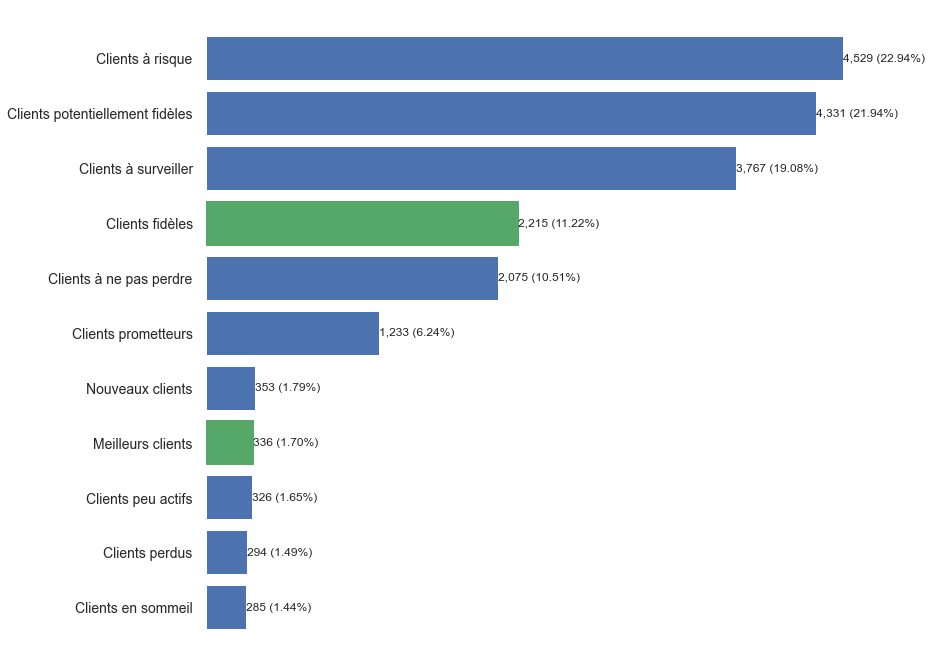

In [52]:
# Appel de la fonction pour l'affichage de segments de clientèle RFM
affich_rfm_segments(df_rfm, 'grp_rfm_segment')

In [53]:
# Calcul de la moyenne pour chaque segment global RFM, et de la taille de chaque segment
df_rfm_agg = df_rfm.groupby('grp_rfm_segment').agg({
    'recency_value': 'mean',
    'frequency_value': 'mean',
    'monetary_value': ['mean', 'count']}).round(1)

df_rfm_agg

recency_value frequency_value monetary_value  \
                                         mean            mean           mean   
grp_rfm_segment                                                                
Clients en sommeil                       79.0             1.0           27.2   
Clients fidèles                          23.9             1.0          182.0   
Clients perdus                           78.6             1.0           27.3   
Clients peu actifs                       56.1             1.0           27.5   
Clients potentiellement fidèles          16.8             1.0           97.3   
Clients prometteurs                      34.0             1.0           59.8   
Clients à ne pas perdre                  65.5             1.0          202.4   
Clients à risque                         72.6             1.0          111.9   
Clients à surveiller                     47.3             1.0          118.2   
Meilleurs clients                        11.7             1.1          264.5   
Nouveaux clients                         12.3             1.0           28.5   

                                       
                                count  
grp_rfm_segment                        
Clients en sommeil                285  
Clients fidèles                  2215  
Clients perdus                    294  
Clients peu actifs                326  
Clients potentiellement fidèles  4331  
Clients prometteurs              1233  
Clients à ne pas perdre          2075  
Clients à risque                 4529  
Clients à surveiller             3767  
Meilleurs clients                 336  
Nouveaux clients                  353

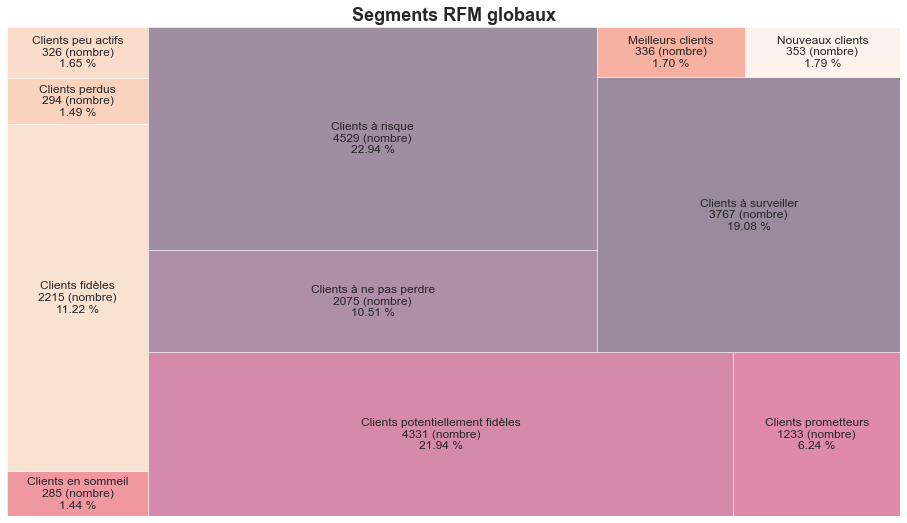

In [54]:
# Appel de la fonction pour l'affichage des segments globaux RFM par squarify
affich_squarify_rfm_segments(df_rfm_agg)

## 5.5 Merge des segments RFM avec le dataset

In [55]:
# Merge des tables "df_ml_data_customer" et "df_rfm" 
df_ml_data_customer_rfm = pd.merge(df_ml_data_customer_filtre, df_rfm,
                    how="left",
                    on="customer_unique_id")

# Liste des variables à supprimer et suppression des variables dans les 2 tables fusionnées
del_features_list = ["recency_value", "frequency_value", "monetary_value"]
df_ml_data_customer_rfm.drop(del_features_list, axis=1, inplace=True)
df_ml_data_customer_rfm.head(3)

,customer_unique_id,nb_orders,mean_payment_sequential,mean_review_score,mean_payment_installments,mean_delivery_days,favorite_purchase_month,favorite_purchase_hour,books_cds_media,fashion_clothing_accessories,...,customer_city,customer_state,Flag and name,harvesine_distance,R,F,M,rfm_segment,rfm_score,grp_rfm_segment
0,00053a61a98854899e70ed204dd4bafe,1,1.0,1.0,3.0,16.0,2,11,0.0,0.0,...,curitiba,Paraná,Paraná,108.557249,3,1,4,314,8,Clients à surveiller
1,0005ef4cd20d2893f0d9fbd94d3c0d97,1,1.0,1.0,4.0,54.0,3,15,0.0,0.0,...,sao luis,Maranhão,Maranhão,1522.737226,4,1,3,413,8,Clients potentiellement fidèles
2,00090324bbad0e9342388303bb71ba0a,1,1.0,5.0,3.0,16.0,3,14,0.0,0.0,...,campinas,São Paulo,São Paulo,209.713834,4,1,2,412,7,Clients potentiellement fidèles


In [56]:
df_ml_data_customer_rfm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19744 entries, 0 to 19743
Data columns (total 33 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   customer_unique_id            19744 non-null  object 
 1   nb_orders                     19744 non-null  int64  
 2   mean_payment_sequential       19744 non-null  float64
 3   mean_review_score             19744 non-null  float64
 4   mean_payment_installments     19744 non-null  float64
 5   mean_delivery_days            19744 non-null  float64
 6   favorite_purchase_month       19744 non-null  int64  
 7   favorite_purchase_hour        19744 non-null  int64  
 8   books_cds_media               19744 non-null  float64
 9   fashion_clothing_accessories  19744 non-null  float64
 10  flowers_gifts                 19744 non-null  float64
 11  groceries_food_drink          19744 non-null  float64
 12  health_beauty                 19744 non-null  float64
 13  h

# 6. Analyse de la qualité de segmentation RFM

Cette analyse permettra d'évaluer la qualité de segmentation RFM par visualisation t-SNE des données dans un espace à 2 et 3 dimensions.

## 6.1 Préparation des données

On sélectionne 22 variables numériques avec les catégories de produit.

On ajoute les segments RFM comme labels pour évaluer la qualité de la segmentation proposée par l'analyse RFM.

In [57]:
# Récupération des variables catégorielles
categorical_features = list(df_ml_data_customer_rfm.select_dtypes(exclude=['int32', 'int64', 'float64']).columns)
categorical_features

['customer_unique_id',
 'customer_city',
 'customer_state',
 'Flag and name',
 'rfm_segment',
 'grp_rfm_segment']

In [58]:
# Récupération des variables numériques
numerical_features = list(df_ml_data_customer_rfm.select_dtypes(include=['int32','int64','float64']).columns)
numerical_features

['nb_orders',
 'mean_payment_sequential',
 'mean_review_score',
 'mean_payment_installments',
 'mean_delivery_days',
 'favorite_purchase_month',
 'favorite_purchase_hour',
 'books_cds_media',
 'fashion_clothing_accessories',
 'flowers_gifts',
 'groceries_food_drink',
 'health_beauty',
 'home_furniture',
 'other',
 'sport',
 'technology',
 'toys_baby',
 'mean_nb_items',
 'order_mean_delay',
 'freight_ratio',
 'mean_price_order',
 'customer_zip_code_prefix',
 'harvesine_distance',
 'R',
 'F',
 'M',
 'rfm_score']

In [59]:
# Liste de colonnes pour les catégories produit
product_category = ['books_cds_media',
 'fashion_clothing_accessories',
 'flowers_gifts',
 'groceries_food_drink',
 'health_beauty',
 'home_furniture',
 'other',
 'sport',
 'technology',
 'toys_baby']

df_ml_data_customer_rfm_categ_prod = df_ml_data_customer_rfm[product_category]
df_ml_data_customer_rfm_categ_prod

,books_cds_media,fashion_clothing_accessories,flowers_gifts,groceries_food_drink,health_beauty,home_furniture,other,sport,technology,toys_baby
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
19739,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
19740,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
19741,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19742,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [190]:
# Dataset avec variables numériques sans RFM, mais avec les données sur la répartition des catégories
#de produit achetés
list_var_num = ['nb_orders',
 'mean_payment_sequential',
 'mean_review_score',
 'mean_payment_installments',
 'mean_delivery_days',
 'favorite_purchase_month',
 'favorite_purchase_hour',
 'books_cds_media',
 'fashion_clothing_accessories',
 'flowers_gifts',
 'groceries_food_drink',
 'health_beauty',
 'home_furniture',
 'other',
 'sport',
 'technology',
 'toys_baby',               
 'mean_nb_items',
 'order_mean_delay',
 'freight_ratio',
 'mean_price_order',
 'harvesine_distance']

df_ml_data_customer_no_rfm_value = df_ml_data_customer_rfm[list_var_num]

In [61]:
df_ml_data_customer_no_rfm_value

,nb_orders,mean_payment_sequential,mean_review_score,mean_payment_installments,mean_delivery_days,favorite_purchase_month,favorite_purchase_hour,books_cds_media,fashion_clothing_accessories,flowers_gifts,...,home_furniture,other,sport,technology,toys_baby,mean_nb_items,order_mean_delay,freight_ratio,mean_price_order,harvesine_distance
0,1,1.0,1.0,3.0,16.0,2,11,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,2.0,32.0,0.09,382.00,108.557249
1,1,1.0,1.0,4.0,54.0,3,15,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,1.0,19.0,0.19,104.90,1522.737226
2,1,1.0,5.0,3.0,16.0,3,14,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,1.0,7.0,0.22,49.95,209.713834
3,1,1.0,5.0,1.0,4.0,1,22,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,1.0,83.0,0.21,28.90,209.713834
4,1,1.0,4.0,6.0,23.0,3,17,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,1.0,26.0,0.19,49.95,209.713834
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19739,1,1.0,1.0,1.0,10.0,2,21,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,1.0,51.0,0.17,179.00,209.713834
19740,1,1.0,5.0,3.0,7.0,3,17,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,24.0,0.18,70.00,493.836401
19741,1,1.0,4.0,2.0,14.0,1,11,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,67.0,0.06,213.90,209.713834
19742,1,1.0,5.0,2.0,17.0,2,12,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,48.0,0.10,199.00,669.215559


In [62]:
# Récupération des labels (segments RFM)
df_ml_data_customer_no_rfm_labels = df_ml_data_customer_rfm[['grp_rfm_segment']]

In [63]:
df_ml_data_customer_no_rfm_labels

,grp_rfm_segment
0,Clients à surveiller
1,Clients potentiellement fidèles
2,Clients potentiellement fidèles
3,Clients perdus
4,Clients prometteurs
...,...
19739,Clients à ne pas perdre
19740,Clients fidèles
19741,Clients à ne pas perdre
19742,Clients à ne pas perdre


## 6.2 Standardisation des données

Utilisation de la méthode MinMaxScaler.

In [64]:
# Appel de la fonction de standardisation
df_ml_data_customer_no_rfm_value_std = std_data(df_ml_data_customer_no_rfm_value, MinMaxScaler())

In [65]:
df_ml_data_customer_no_rfm_value_std

,nb_orders,mean_payment_sequential,mean_review_score,mean_payment_installments,mean_delivery_days,favorite_purchase_month,favorite_purchase_hour,books_cds_media,fashion_clothing_accessories,flowers_gifts,...,home_furniture,other,sport,technology,toys_baby,mean_nb_items,order_mean_delay,freight_ratio,mean_price_order,harvesine_distance
0,0.0,0.0,0.00,0.086957,0.137615,0.5,0.478261,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.076923,0.351955,0.1000,0.384388,0.000000
1,0.0,0.0,0.00,0.130435,0.486239,1.0,0.652174,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.000000,0.206704,0.2250,0.103356,0.714672
2,0.0,0.0,1.00,0.086957,0.137615,1.0,0.608696,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.000000,0.072626,0.2625,0.047626,0.051121
3,0.0,0.0,1.00,0.000000,0.027523,0.0,0.956522,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.000000,0.921788,0.2500,0.026278,0.051121
4,0.0,0.0,0.75,0.217391,0.201835,1.0,0.739130,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.000000,0.284916,0.2250,0.047626,0.051121
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19739,0.0,0.0,0.00,0.000000,0.082569,0.5,0.913043,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.000000,0.564246,0.2000,0.178507,0.051121
19740,0.0,0.0,1.00,0.086957,0.055046,1.0,0.739130,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.262570,0.2125,0.067961,0.194705
19741,0.0,0.0,0.75,0.043478,0.119266,0.0,0.478261,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.743017,0.0625,0.213902,0.051121
19742,0.0,0.0,1.00,0.043478,0.146789,0.5,0.521739,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.530726,0.1125,0.198791,0.283335


## 6.3 Visualisation T-SNE 2D

Initialisation T-SNE par un réduction de PCA, puis visualisation T-SNE dans un espace à 2 dimensions avec 22 variables en entrée.

In [66]:
# Appel de la fonction pour calcul T-SNE sur 2 axes
data_projected_no_rfm = classif_tsne(df_ml_data_customer_no_rfm_value_std,2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 19744 samples in 0.001s...
[t-SNE] Computed neighbors for 19744 samples in 32.583s...
[t-SNE] Computed conditional probabilities for sample 1000 / 19744
[t-SNE] Computed conditional probabilities for sample 2000 / 19744
[t-SNE] Computed conditional probabilities for sample 3000 / 19744
[t-SNE] Computed conditional probabilities for sample 4000 / 19744
[t-SNE] Computed conditional probabilities for sample 5000 / 19744
[t-SNE] Computed conditional probabilities for sample 6000 / 19744
[t-SNE] Computed conditional probabilities for sample 7000 / 19744
[t-SNE] Computed conditional probabilities for sample 8000 / 19744
[t-SNE] Computed conditional probabilities for sample 9000 / 19744
[t-SNE] Computed conditional probabilities for sample 10000 / 19744
[t-SNE] Computed conditional probabilities for sample 11000 / 19744
[t-SNE] Computed conditional probabilities for sample 12000 / 19744
[t-SNE] Computed conditional probabilities for sa

In [67]:
# Préparation des données pour affichage des points 
df_tsne_no_rfm_2d = pd.DataFrame()
df_tsne_no_rfm_2d['labels'] = df_ml_data_customer_no_rfm_labels['grp_rfm_segment']
df_tsne_no_rfm_2d['tsne-2d-axe 1'] = data_projected_no_rfm[:,0]
df_tsne_no_rfm_2d['tsne-2d-axe 2'] = data_projected_no_rfm[:,1]
df_tsne_no_rfm_2d

,labels,tsne-2d-axe 1,tsne-2d-axe 2
0,Clients à surveiller,0.969470,-0.096439
1,Clients potentiellement fidèles,8.180288,-0.465130
2,Clients potentiellement fidèles,4.078256,6.039094
3,Clients perdus,-9.074394,-6.109408
4,Clients prometteurs,7.249213,5.556602
...,...,...,...
19739,Clients à ne pas perdre,3.644421,11.711526
19740,Clients fidèles,10.338696,-4.423735
19741,Clients à ne pas perdre,-4.066199,1.927767
19742,Clients à ne pas perdre,-0.539305,1.067288


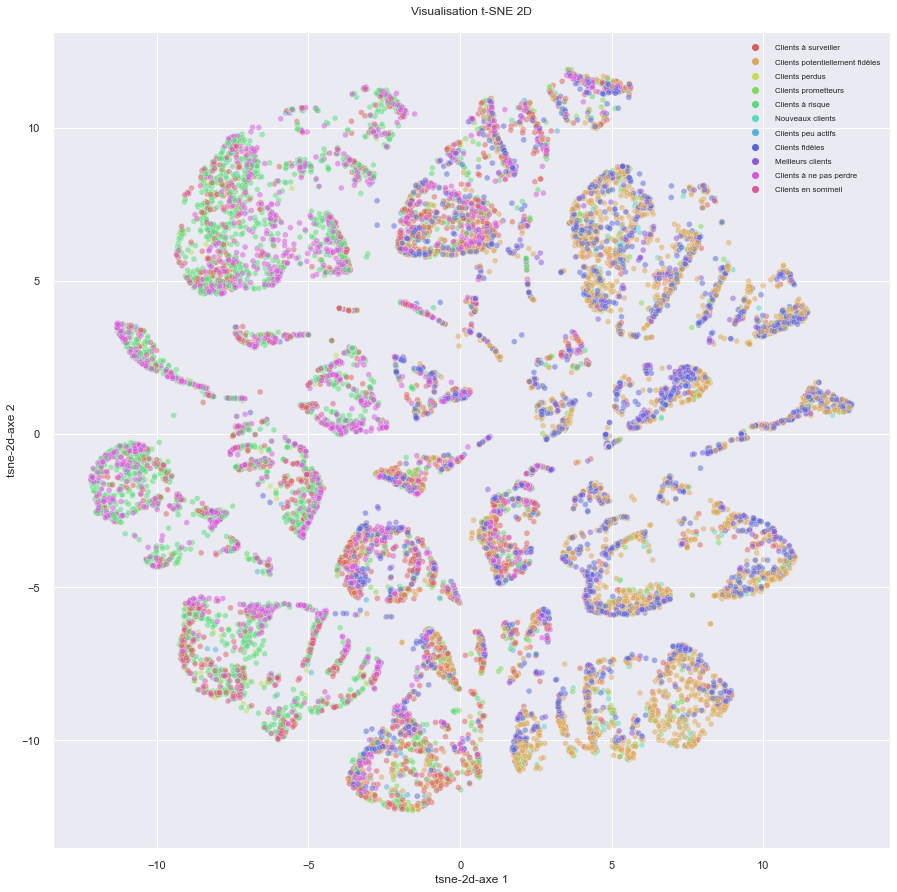

In [68]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_no_rfm_2d,11)

Le graphe ci-dessus montre qu'il n'y a pas de groupements distincts (tous les points sont mélangés), suite à l'analyse RFM.

On va tenter une visualisation des regroupements par T-SNE 3D intéractif pour tenter de voir plus finement les regroupements.

## 6.4 Visualisation T-SNE 3D - Graphe interactif

Réduction de dimensions PCA, puis visualisation T-SNE 3D interactif dans un espace à 3 dimensions avec 22 variables en entrée.

In [69]:
# Appel de la fonction pour calcul T-SNE sur 3 composants
data_projected_no_rfm = classif_tsne(df_ml_data_customer_no_rfm_value_std,3)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 19744 samples in 0.002s...
[t-SNE] Computed neighbors for 19744 samples in 18.587s...
[t-SNE] Computed conditional probabilities for sample 1000 / 19744
[t-SNE] Computed conditional probabilities for sample 2000 / 19744
[t-SNE] Computed conditional probabilities for sample 3000 / 19744
[t-SNE] Computed conditional probabilities for sample 4000 / 19744
[t-SNE] Computed conditional probabilities for sample 5000 / 19744
[t-SNE] Computed conditional probabilities for sample 6000 / 19744
[t-SNE] Computed conditional probabilities for sample 7000 / 19744
[t-SNE] Computed conditional probabilities for sample 8000 / 19744
[t-SNE] Computed conditional probabilities for sample 9000 / 19744
[t-SNE] Computed conditional probabilities for sample 10000 / 19744
[t-SNE] Computed conditional probabilities for sample 11000 / 19744
[t-SNE] Computed conditional probabilities for sample 12000 / 19744
[t-SNE] Computed conditional probabilities for sa

In [70]:
# Préparation des données pour affichage des points 
df_tsne_no_rfm_3d = pd.DataFrame()
df_tsne_no_rfm_3d['labels'] = df_ml_data_customer_no_rfm_labels['grp_rfm_segment']
df_tsne_no_rfm_3d['tsne-3d-axe 1'] = data_projected_no_rfm[:,0]
df_tsne_no_rfm_3d['tsne-3d-axe 2'] = data_projected_no_rfm[:,1]
df_tsne_no_rfm_3d['tsne-3d-axe 3'] = data_projected_no_rfm[:,2]
df_tsne_no_rfm_3d

,labels,tsne-3d-axe 1,tsne-3d-axe 2,tsne-3d-axe 3
0,Clients à surveiller,-2.696813,-5.617138,0.302572
1,Clients potentiellement fidèles,4.230561,-3.449802,-0.291444
2,Clients potentiellement fidèles,3.730820,4.499048,-2.180836
3,Clients perdus,-5.503649,-4.328882,1.738292
4,Clients prometteurs,5.365963,2.288284,0.907509
...,...,...,...,...
19739,Clients à ne pas perdre,0.217339,4.484135,4.722941
19740,Clients fidèles,4.893143,-3.855200,-3.830849
19741,Clients à ne pas perdre,-2.733519,0.149433,-0.458931
19742,Clients à ne pas perdre,-0.981728,2.170824,-2.284816


In [71]:
proj_grade_tsne_3d_interactif(df_tsne_no_rfm_3d)

Comme la visualisation des points T-SNE en 2D, la visualisation T-SNE en 3D ne permet pas de distinguer des regroupements distincts par rapport aux segments RFM. 

On aboutit à la conclusion suivante: l'ajout des catégories de produit dans le jeu de données ne permet pas à l'analyse RFM d'identifier des groupements cohérents, il faut tenter de déterminer des clusters de meilleure qualité avec les algorithmes de clustering non supervisés (K-means, DBSCAN, clustering hiérarchique).

# 7. Classification par algorithmes de clustering non supervisés

A présent, nous reprenons le jeu de données du point 6 (22 variables en entrée) et nous allons utilser des méthodes de clustering non supervisés afin de trouver un segmentation plus simple à utiliser et de meilleure qualité.

## 7.1 Préparation des données

In [72]:
# Dataset avec variables numériques
list_var_num2 = ['nb_orders',
 'mean_payment_sequential',
 'mean_review_score',
 'mean_payment_installments',
 'mean_delivery_days',
 'favorite_purchase_month',
 'favorite_purchase_hour',
 'books_cds_media',
 'fashion_clothing_accessories',
 'flowers_gifts',
 'groceries_food_drink',
 'health_beauty',
 'home_furniture',
 'other',
 'sport',
 'technology',
 'toys_baby',                
 'mean_nb_items',
 'order_mean_delay',
 'freight_ratio',
 'mean_price_order',
 'harvesine_distance']

df_ml_data_customer_rfm_value = df_ml_data_customer_rfm[list_var_num2]
df_ml_data_customer_rfm_value

,nb_orders,mean_payment_sequential,mean_review_score,mean_payment_installments,mean_delivery_days,favorite_purchase_month,favorite_purchase_hour,books_cds_media,fashion_clothing_accessories,flowers_gifts,...,home_furniture,other,sport,technology,toys_baby,mean_nb_items,order_mean_delay,freight_ratio,mean_price_order,harvesine_distance
0,1,1.0,1.0,3.0,16.0,2,11,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,2.0,32.0,0.09,382.00,108.557249
1,1,1.0,1.0,4.0,54.0,3,15,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,1.0,19.0,0.19,104.90,1522.737226
2,1,1.0,5.0,3.0,16.0,3,14,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,1.0,7.0,0.22,49.95,209.713834
3,1,1.0,5.0,1.0,4.0,1,22,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,1.0,83.0,0.21,28.90,209.713834
4,1,1.0,4.0,6.0,23.0,3,17,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,1.0,26.0,0.19,49.95,209.713834
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19739,1,1.0,1.0,1.0,10.0,2,21,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,1.0,51.0,0.17,179.00,209.713834
19740,1,1.0,5.0,3.0,7.0,3,17,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,24.0,0.18,70.00,493.836401
19741,1,1.0,4.0,2.0,14.0,1,11,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,67.0,0.06,213.90,209.713834
19742,1,1.0,5.0,2.0,17.0,2,12,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,48.0,0.10,199.00,669.215559


## 7.2 Calcul PCA

Utilisation de la PCA pour évaluer la prépondérance des variables en entrée.

### 7.2.1 Diagramme des éboulis des vecteurs propres

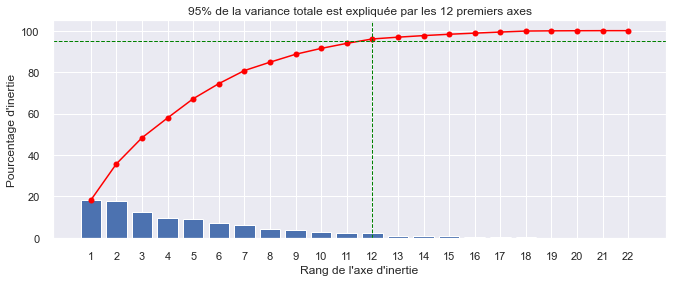

In [73]:
# Appel de la fonction pour calcul PCA et affichage du diagramme des éboulis des vecteurs propres
data_pca, pcs, pca, features, data_pca_projeted = calcul_pca(df_ml_data_customer_rfm_value, 'O', MinMaxScaler())

Dans le cadre d'un jeu de données avec peu de dimensions, la PCA n'est pas utlisée dans le but de réduire les dimensions. Nous allons plutôt utiliser le PCA pour déterminer le variables les plus prépondérantes sur les 3 premiers plans factoriels.

In [189]:
# Cumul de la variance expliquée sur 3 premiers plans factoriels
varexpl = pca.named_steps['pca'].explained_variance_ratio_*100
print("Le premier plan factoriel couvre une inertie cumulée de {:.2f}%, le second plan {:.2f}% \
et le 3ème plan {:.2f}%.".format(varexpl[0:2].sum(),varexpl[0:4].sum(),varexpl[0:6].sum()))

Le premier plan factoriel couvre une inertie cumulée de 35.67%, le second plan 57.86% et le 3ème plan 74.41%.


### 7.2.2 Affichage du cercle de corrélations sur le premier plan factoriel

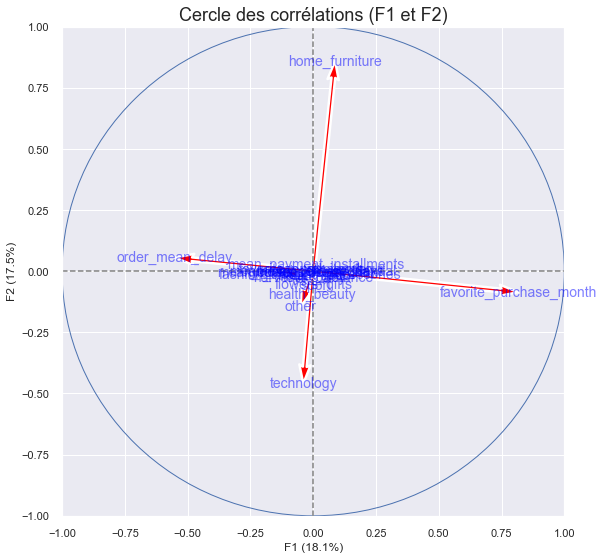

In [75]:
affich_cercle_corr(pcs,data_pca.shape[1], pca, (0,1), labels = np.array(features))

### 7.2.3 Affichage du cercle de corrélations sur le second plan factoriel

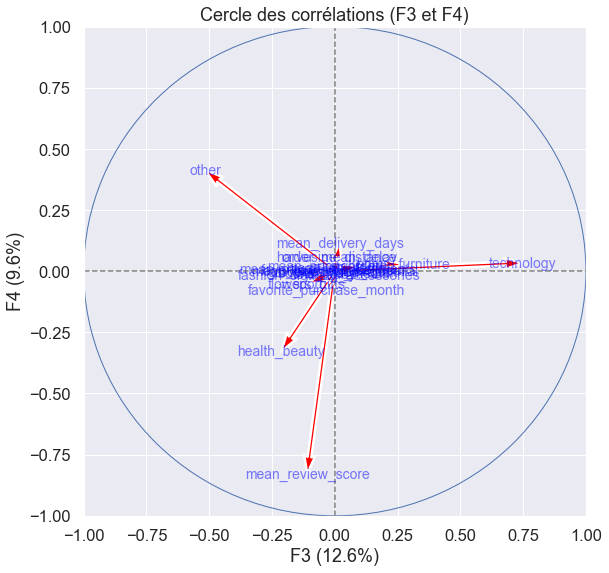

In [76]:
affich_cercle_corr(pcs,data_pca.shape[1], pca, (2,3), labels = np.array(features))

### 7.2.4 Affichage du cercle de corrélations sur le troisième plan factoriel

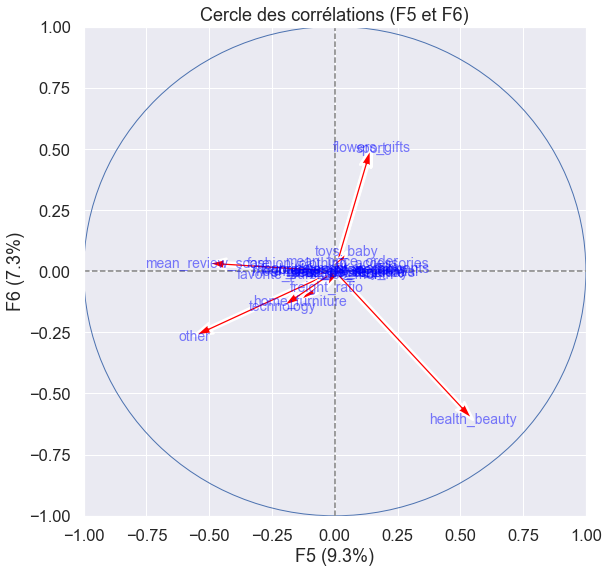

In [77]:
affich_cercle_corr(pcs,data_pca.shape[1], pca, (4,5), labels = np.array(features))

L'analyse des 4 premiers plans factoriels permet de voir les variables qui contribuent le plus à chaque axe:
- **la variable synthétique F1 représente principalement les délais d'achat entre 2 commandes** (corrélation négative entre les variables "favorite_purchase_month" et "order_mean_delay").
  

- **la variable synthétique F2 représente principalement les clients qui achètent des fournitures pour la maison** (corrélation positive avec la variable "home_furniture").

  
- **la variable synthétique F3 représente principalement les clients qui achètent des produits technologiques** (corrélation positive avec la variable "technology").


- **la variable synthétique F4 représente principalement la satisfaction / insatisfaction client** (corrélation positive avec la variable "mean_review_score").
   

- **la variable synthétique F5 représente principalement les clients qui achètent des produits santé et beauté** (corrélation positive avec la variable "health_beauty").


- **la variable synthétique F6 représente principalement les clients qui achètent des fleurs et des articles de sport** (corrélation positive avec las variables "flower_gifts" et "sport".

## 7.3 Standardisation des données

In [78]:
# Appel de la fonction de standardisation
df_ml_data_customer_rfm_value_std = std_data(df_ml_data_customer_rfm_value, MinMaxScaler())

In [79]:
df_ml_data_customer_rfm_value_std

,nb_orders,mean_payment_sequential,mean_review_score,mean_payment_installments,mean_delivery_days,favorite_purchase_month,favorite_purchase_hour,books_cds_media,fashion_clothing_accessories,flowers_gifts,...,home_furniture,other,sport,technology,toys_baby,mean_nb_items,order_mean_delay,freight_ratio,mean_price_order,harvesine_distance
0,0.0,0.0,0.00,0.086957,0.137615,0.5,0.478261,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.076923,0.351955,0.1000,0.384388,0.000000
1,0.0,0.0,0.00,0.130435,0.486239,1.0,0.652174,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.000000,0.206704,0.2250,0.103356,0.714672
2,0.0,0.0,1.00,0.086957,0.137615,1.0,0.608696,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.000000,0.072626,0.2625,0.047626,0.051121
3,0.0,0.0,1.00,0.000000,0.027523,0.0,0.956522,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.000000,0.921788,0.2500,0.026278,0.051121
4,0.0,0.0,0.75,0.217391,0.201835,1.0,0.739130,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.000000,0.284916,0.2250,0.047626,0.051121
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19739,0.0,0.0,0.00,0.000000,0.082569,0.5,0.913043,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.000000,0.564246,0.2000,0.178507,0.051121
19740,0.0,0.0,1.00,0.086957,0.055046,1.0,0.739130,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.262570,0.2125,0.067961,0.194705
19741,0.0,0.0,0.75,0.043478,0.119266,0.0,0.478261,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.743017,0.0625,0.213902,0.051121
19742,0.0,0.0,1.00,0.043478,0.146789,0.5,0.521739,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.530726,0.1125,0.198791,0.283335


## 7.4 Réduction de dimensions / Visualisation T-SNE 2D

Après réduction PCA en initialisation du T-SNE, visualisation T-SNE dans un espace à 2 dimensions avec 22 variables en entrée.

In [80]:
# Appel de la fonction pour calcul T-SNE sur 2 axes
data_projected_rfm_2d = classif_tsne(df_ml_data_customer_rfm_value_std,2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 19744 samples in 0.001s...
[t-SNE] Computed neighbors for 19744 samples in 30.686s...
[t-SNE] Computed conditional probabilities for sample 1000 / 19744
[t-SNE] Computed conditional probabilities for sample 2000 / 19744
[t-SNE] Computed conditional probabilities for sample 3000 / 19744
[t-SNE] Computed conditional probabilities for sample 4000 / 19744
[t-SNE] Computed conditional probabilities for sample 5000 / 19744
[t-SNE] Computed conditional probabilities for sample 6000 / 19744
[t-SNE] Computed conditional probabilities for sample 7000 / 19744
[t-SNE] Computed conditional probabilities for sample 8000 / 19744
[t-SNE] Computed conditional probabilities for sample 9000 / 19744
[t-SNE] Computed conditional probabilities for sample 10000 / 19744
[t-SNE] Computed conditional probabilities for sample 11000 / 19744
[t-SNE] Computed conditional probabilities for sample 12000 / 19744
[t-SNE] Computed conditional probabilities for sa

In [81]:
# Préparation des données pour affichage des points 
df_tsne_rfm_2d = pd.DataFrame()
df_tsne_rfm_2d['tsne-2d-axe 1'] = data_projected_rfm_2d[:,0]
df_tsne_rfm_2d['tsne-2d-axe 2'] = data_projected_rfm_2d[:,1]
df_tsne_rfm_2d

,tsne-2d-axe 1,tsne-2d-axe 2
0,0.969539,-0.100485
1,8.192674,-0.471216
2,4.054979,6.007330
3,-9.099467,-6.137505
4,7.238705,5.565848
...,...,...
19739,3.835681,11.579696
19740,10.326876,-4.399666
19741,-4.091373,1.933107
19742,-0.542887,1.057434


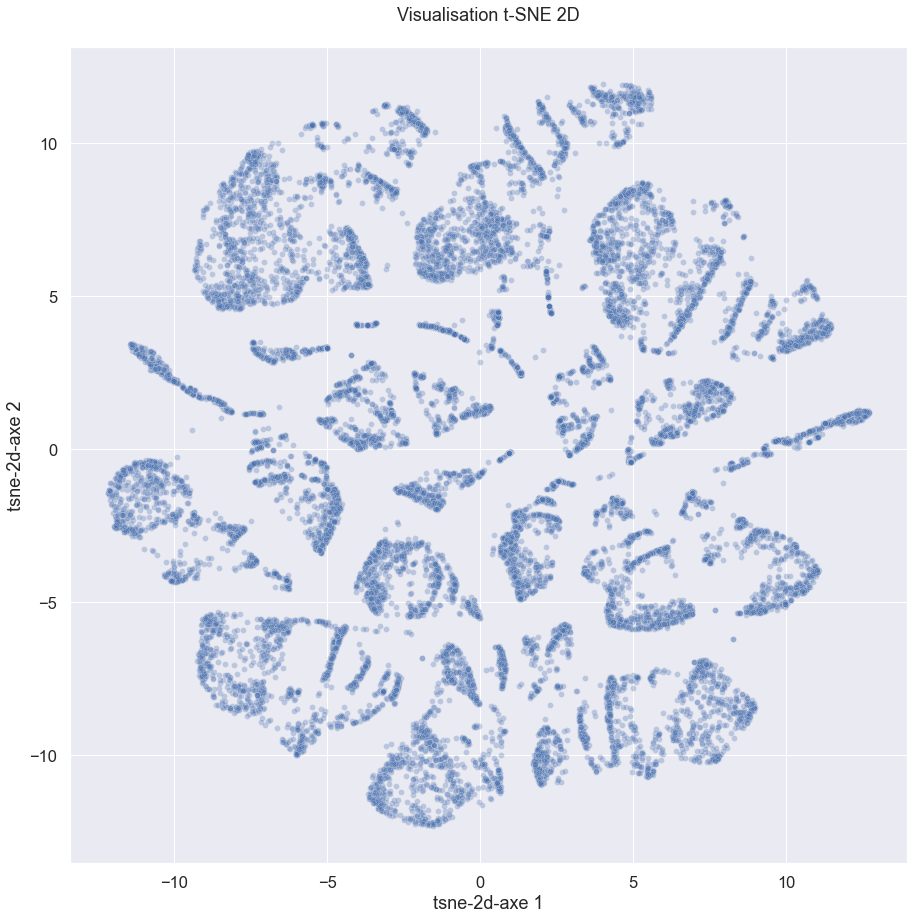

In [82]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne_no_label(df_tsne_rfm_2d)

La visualisation T-SNE 2D ne permet pas de dégager des regroupements distincts et très marqués.

Nous allons essayer de distinguer des informations supplémentaires avec la visualisation T-SNE 3D en mode intéractif.

## 7.5 Reduction de dimensions / Visualisation T-SNE 3D - Graphe intéractif

In [83]:
# Appel de la fonction pour calcul T-SNE sur 3 axes
data_projected_rfm_3d= classif_tsne(df_ml_data_customer_rfm_value_std,3)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 19744 samples in 0.002s...
[t-SNE] Computed neighbors for 19744 samples in 23.787s...
[t-SNE] Computed conditional probabilities for sample 1000 / 19744
[t-SNE] Computed conditional probabilities for sample 2000 / 19744
[t-SNE] Computed conditional probabilities for sample 3000 / 19744
[t-SNE] Computed conditional probabilities for sample 4000 / 19744
[t-SNE] Computed conditional probabilities for sample 5000 / 19744
[t-SNE] Computed conditional probabilities for sample 6000 / 19744
[t-SNE] Computed conditional probabilities for sample 7000 / 19744
[t-SNE] Computed conditional probabilities for sample 8000 / 19744
[t-SNE] Computed conditional probabilities for sample 9000 / 19744
[t-SNE] Computed conditional probabilities for sample 10000 / 19744
[t-SNE] Computed conditional probabilities for sample 11000 / 19744
[t-SNE] Computed conditional probabilities for sample 12000 / 19744
[t-SNE] Computed conditional probabilities for sa

In [84]:
# Préparation des données pour affichage des points 
df_tsne_rfm_3d = pd.DataFrame()
df_tsne_rfm_3d['tsne-3d-axe 1'] = data_projected_rfm_3d[:,0]
df_tsne_rfm_3d['tsne-3d-axe 2'] = data_projected_rfm_3d[:,1]
df_tsne_rfm_3d['tsne-3d-axe 3'] = data_projected_rfm_3d[:,2]
df_tsne_rfm_3d

,tsne-3d-axe 1,tsne-3d-axe 2,tsne-3d-axe 3
0,-2.622433,-5.711923,0.295667
1,4.213441,-3.439202,-0.290927
2,3.666024,4.469151,-2.162904
3,-5.496171,-4.333920,1.739062
4,5.349966,2.301671,0.901070
...,...,...,...
19739,0.357308,4.667121,4.780676
19740,4.894441,-3.859540,-3.833016
19741,-2.730766,0.154024,-0.452005
19742,-1.037844,2.129923,-2.323327


In [85]:
#proj_grade_tsne_3d_no_label(df_tsne_rfm_3d)
proj_grade_tsne_3d_interactif_no_label(df_tsne_rfm_3d)

Les points projetés dans le T-SNE 3D n'est pas beaucoup plus parlant que la représentation 2D.

A présent, nous allons tenter de déterminer des clusters plus précis avec des algorithmes non supervisés (k-means, DBSCAN, cluster hiérarchique).

# 8 Applications d'algorithmes de classification non supervisés

## 8.1 K-means

Détermination du k-means avec les données du dataset.

### 8.1.1 Détermination du nombre K de clusters

#### 8.1.1.1 Détermination du nombre de clusters pour la méthode du coude - methode manuelle

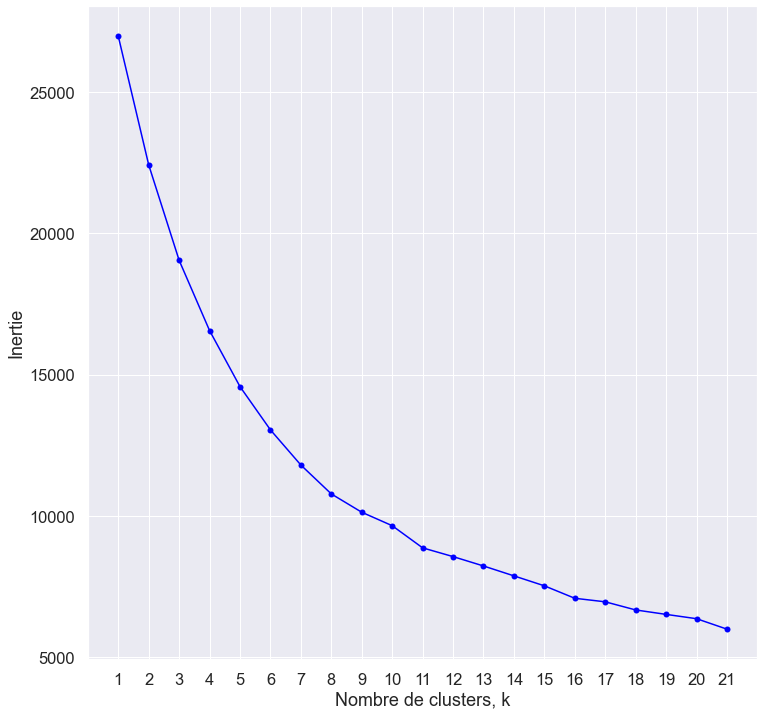

In [90]:
# K-means: détermination du nombre du clusters (détermination du coude)
ks = range(1, 22)
inertias = []

for k in ks:
    model = KMeans(n_clusters=k, init='k-means++')
    
    model.fit(df_ml_data_customer_rfm_value_std)
    
    inertias.append(model.inertia_)
    
plt.plot(ks, inertias, '-o', color='blue')
plt.xlabel('Nombre de clusters, k')
plt.ylabel('Inertie')
plt.xticks(ks)
plt.show()

Le coude n'est pas vraiment marqué: il semblerait que la valeur K soit entre 6 et 7.

#### 8.1.1.2 Détermination du nombre de clusters pour la méthode du coude  - score de distorsion (librairie Yellowbrick)

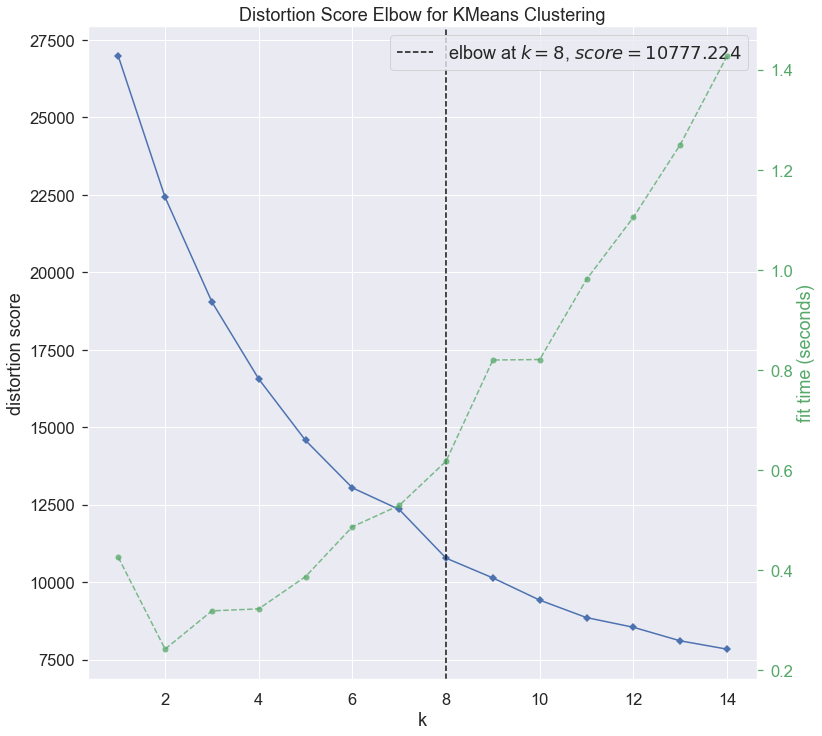

In [87]:
# Appel de la fonction pour détermination de nombre de cluster par la méthode du coude
calcul_nbre_cluster_kmeans(df_ml_data_customer_rfm_value_std,1,22,'distortion')

Grâce à la méthode du coude basée sur le score de distorsion (somme moyenne des carrés des distances aux centres) et en utilisation le visualiser de la librairie Yellowbricks, une segmentation en 8 clusters (K = 8) serait la meilleure option.

#### 8.1.1.3 Détermination du nombre de clusters en calculant le coefficient de silhouette optimal

Comme les 2 précédentes méthodes n'indiquent pas le même nombre de clusters (K), nous déterminerons le nombre K de clusters en calculant le coefficient de silhouette optimal.

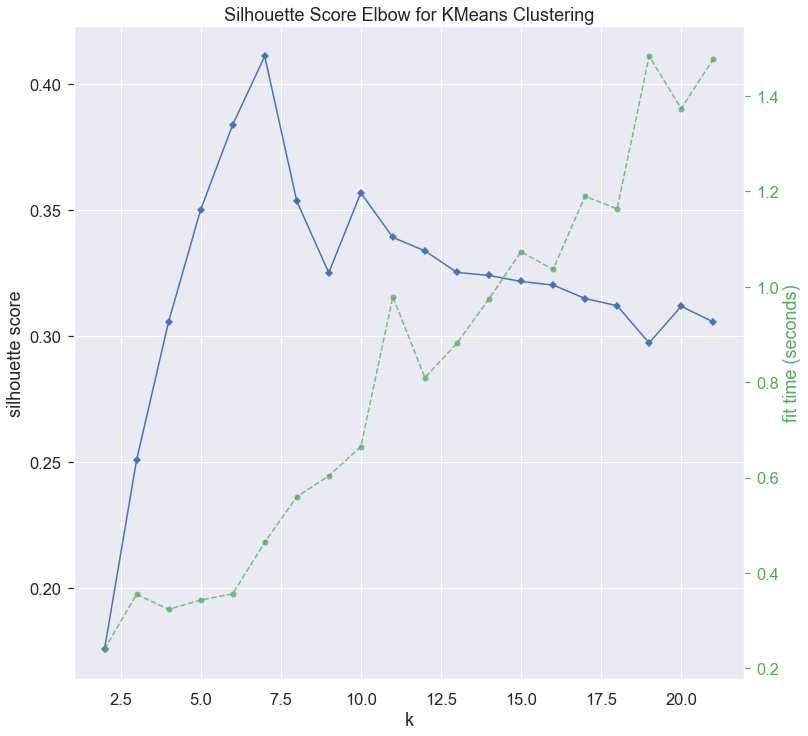

In [92]:
# Appel de la fonction pour détermination de nombre de cluster par la méthode du coude
calcul_nbre_cluster_kmeans(df_ml_data_customer_rfm_value_std,2,22,'silhouette')

Nous avons déterminer le nombre de clusters K en calculant le coefficient de silhouette optimal selon la valeur K.

Le coefficient de silhouette optimal détermine une valeur de K = 7.

#### 8.1.1.4 Détermination finale du nombre de clusters avec le score de silhouette 

In [93]:
# Détermination duscore de silhouette pour nombre de clusters de 2 à 5
range_n_clusters = [4,5,6,7,8]
for n_clusters in range_n_clusters:
    
    # Calcul du k-means
    cluster_kmeans, labels_kmeans = calcul_kmeans(df_ml_data_customer_rfm_value_std, n_clusters)
    
    # Calcul du score de silhouette
    silhouette_avg = silhouette_score(df_ml_data_customer_rfm_value_std, labels_kmeans)
    print("Pour K (nbre clusters) =", n_clusters,"le score moyen de silhouette est de :", silhouette_avg)

Pour K (nbre clusters) = 4 le score moyen de silhouette est de : 0.30566249361812076
Pour K (nbre clusters) = 5 le score moyen de silhouette est de : 0.3500473968677848
Pour K (nbre clusters) = 6 le score moyen de silhouette est de : 0.38372042265727946
Pour K (nbre clusters) = 7 le score moyen de silhouette est de : 0.4109699360323414
Pour K (nbre clusters) = 8 le score moyen de silhouette est de : 0.35574807831643845


Nous optons définitivement pour un nombre de clusters K = 7.

#### 8.1.1.5 Calcul K-means

In [94]:
# Calcul du k-means avec K=7
cluster_kmeans, labels_kmeans = calcul_kmeans(df_ml_data_customer_rfm_value_std, 7)

In [95]:
cluster_kmeans

KMeans(n_clusters=7)

In [96]:
labels_kmeans

array([6, 6, 2, ..., 0, 0, 5])

### 8.1.2 Visualisation T-SNE 2D avec les clusters k-means

In [97]:
# Préparation des données pour affichage des points 
df_tsne_rfm_kmeans = pd.DataFrame()
df_tsne_rfm_kmeans['labels'] = labels_kmeans
df_tsne_rfm_kmeans['tsne-2d-axe 1'] = data_projected_rfm_2d[:,0]
df_tsne_rfm_kmeans['tsne-2d-axe 2'] = data_projected_rfm_2d[:,1]
df_tsne_rfm_kmeans

,labels,tsne-2d-axe 1,tsne-2d-axe 2
0,6,0.969539,-0.100485
1,6,8.192674,-0.471216
2,2,4.054979,6.007330
3,1,-9.099467,-6.137505
4,2,7.238705,5.565848
...,...,...,...
19739,2,3.835681,11.579696
19740,3,10.326876,-4.399666
19741,0,-4.091373,1.933107
19742,0,-0.542887,1.057434


In [98]:
# Nombre de clients par cluster
df_tsne_rfm_kmeans['labels'].value_counts()

2    5387
1    3869
4    2838
3    2274
5    1981
6    1707
0    1688
Name: labels, dtype: int64

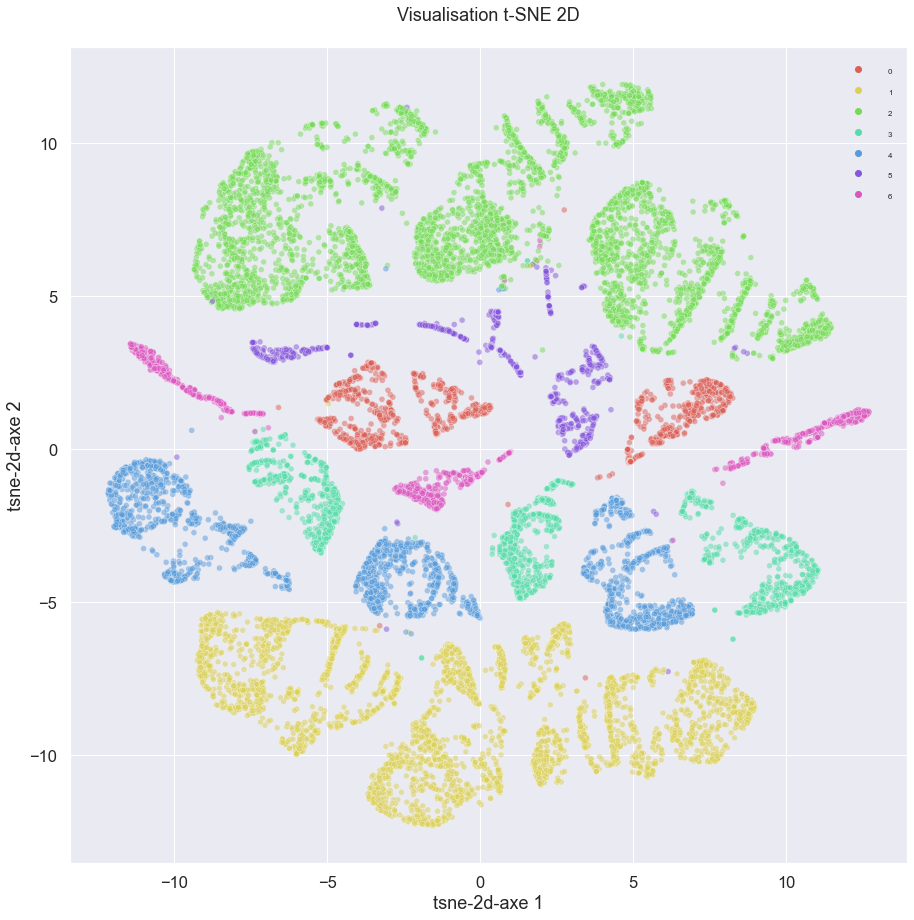

In [99]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_rfm_kmeans, 7)

### 8.1.3 Visualisation T-SNE 3D avec les clusters k-means - Graphe intéractif

In [100]:
# Préparation des données pour affichage des points 
df_tsne_rfm_kmeans_3d = pd.DataFrame()
df_tsne_rfm_kmeans_3d['labels'] = labels_kmeans
df_tsne_rfm_kmeans_3d['tsne-3d-axe 1'] = data_projected_rfm_3d[:,0]
df_tsne_rfm_kmeans_3d['tsne-3d-axe 2'] = data_projected_rfm_3d[:,1]
df_tsne_rfm_kmeans_3d['tsne-3d-axe 3'] = data_projected_rfm_3d[:,2]
df_tsne_rfm_kmeans_3d

,labels,tsne-3d-axe 1,tsne-3d-axe 2,tsne-3d-axe 3
0,6,-2.622433,-5.711923,0.295667
1,6,4.213441,-3.439202,-0.290927
2,2,3.666024,4.469151,-2.162904
3,1,-5.496171,-4.333920,1.739062
4,2,5.349966,2.301671,0.901070
...,...,...,...,...
19739,2,0.357308,4.667121,4.780676
19740,3,4.894441,-3.859540,-3.833016
19741,0,-2.730766,0.154024,-0.452005
19742,0,-1.037844,2.129923,-2.323327


In [101]:
proj_grade_tsne_3d_interactif(df_tsne_rfm_kmeans_3d)

La projection des points en sortie du T-SNE 2D avec les labels des clusters k-means permet de visualiser des groupes homogènes de données en fonction les clusters K-means.

La projection de ces mêmes points en 3D confirment ces résultats.

Il y a tout de même quelques points parasites.

## 8.2 DBSCAN dans espace à 2 dimensions

Pour l'algorithme DBSCAN, il faut déterminer 2 paramètres:
- min_samples : le plus petit nombre de points requis pour former un cluster.
- eps (epsilon) : la distance maximale entre deux points appartenant à un même cluster.

Pour le paramètre min_samples, nos prendrons un échantillon significatif, soit 2xnombre dimensions = 44.

Pour le paramètre eps, nous allons déterminer le paramètre en calculant la distance moyenne entre chaque point et ses n_neighbors. Le seul paramètre à définir est n_neighbors.

### 8.2.1 Détermination de la valeur optimale pour le paramètre epsilon

In [102]:
# Calcul de la distance moyenne entre chaque point et ses n_neighbors
neighbors = NearestNeighbors(n_neighbors=5000)
neighbors_fit = neighbors.fit(df_ml_data_customer_rfm_value_std)
distances, indices = neighbors_fit.kneighbors(df_ml_data_customer_rfm_value_std)

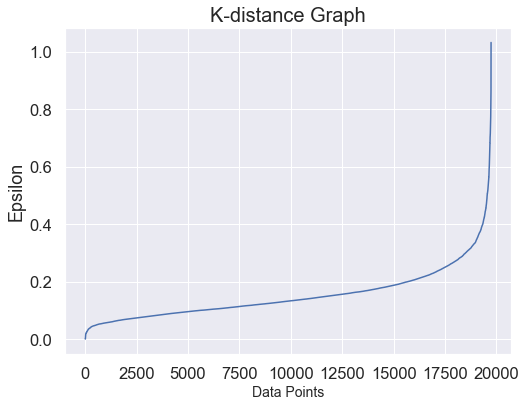

In [103]:
distances = np.sort(distances, axis=0) 
distances = distances[:,1] 
plt.figure(figsize=(8,6))
plt.plot(distances)
plt.title('K-distance Graph',fontsize=20)
plt.xlabel('Data Points',fontsize=14)
plt.ylabel('Epsilon')
plt.show()

Valeur du coude pour déterminer epsilon (environ 0,3).

### 8.2.2 Calcul du clustering DBSCAN

Calcul du DBSCAN avec min_samples(minpts) = 2*nombre de dimensions du jeu de données = 44.

Détermination de la valeur eps manuellement à partir de la valeur 0,3.

In [113]:
# Appel de la fonction pour clustering DBSCAN
dbscan_model, labels_dbscan = clustering_dbscan(df_ml_data_customer_rfm_value_std,44,0.54)

Nombre estimé de clusters: 9
Nombre estimé de points de bruits: 594
Coefficient silhouette: 0.413


Calcul du DBSCAN avec min_samples=44 et eps=0.5

In [114]:
dbscan_model

DBSCAN(eps=0.54, min_samples=44)

In [115]:
labels_dbscan

array([ 0,  0,  1, ...,  6,  6, -1], dtype=int64)

### 8.2.3 Visualisation T-SNE 2D avec les clusters dbscan

In [116]:
# Préparation des données pour affichage des points 
df_tsne_rfm_dbscan = pd.DataFrame()
df_tsne_rfm_dbscan['labels'] = labels_dbscan
df_tsne_rfm_dbscan['tsne-2d-axe 1'] = data_projected_rfm_2d[:,0]
df_tsne_rfm_dbscan['tsne-2d-axe 2'] = data_projected_rfm_2d[:,1]
df_tsne_rfm_dbscan

,labels,tsne-2d-axe 1,tsne-2d-axe 2
0,0,0.969539,-0.100485
1,0,8.192674,-0.471216
2,1,4.054979,6.007330
3,2,-9.099467,-6.137505
4,1,7.238705,5.565848
...,...,...,...
19739,1,3.835681,11.579696
19740,3,10.326876,-4.399666
19741,6,-4.091373,1.933107
19742,6,-0.542887,1.057434


In [117]:
# Nombre de clients par cluster
df_tsne_rfm_dbscan['labels'].value_counts()

 1    5328
 2    3834
 4    2790
 3    2242
 0    1679
 6    1650
 8     942
-1     594
 7     517
 5     168
Name: labels, dtype: int64

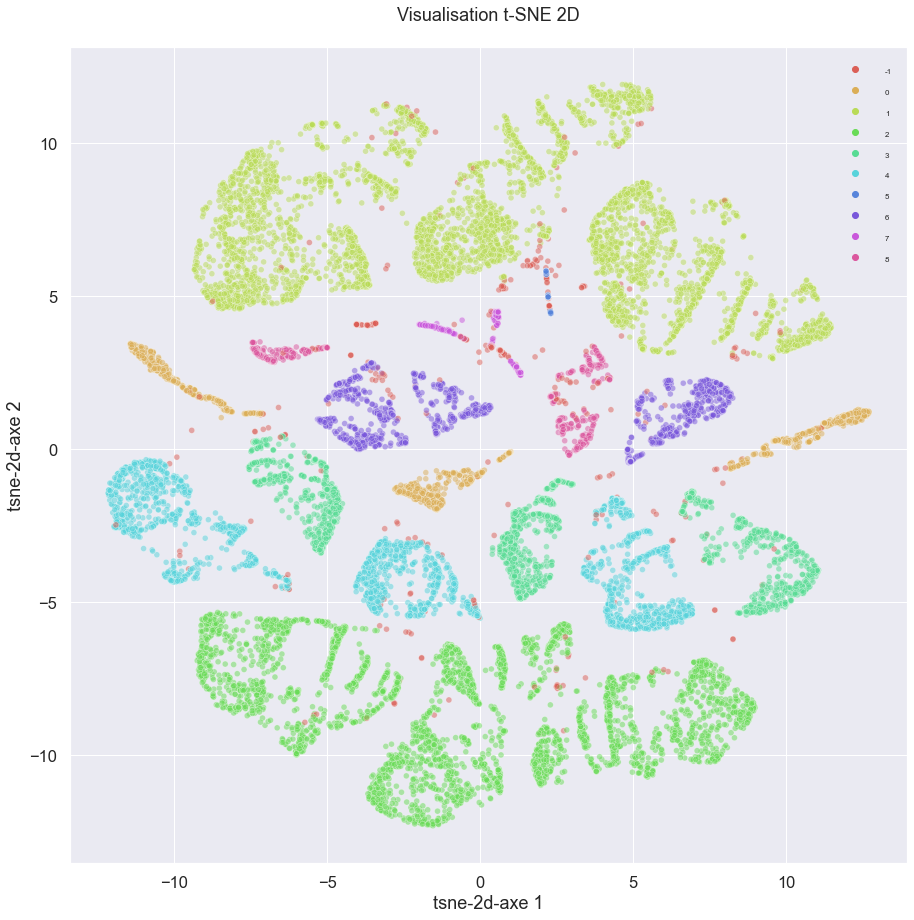

In [118]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_rfm_dbscan, 10)

La visualisation T-SNE 2D montre que la clusters 5 et 7 présentent des points isolés.

### 8.2.4 Visualisation T-SNE 3D avec les clusters dbscan - Graphe intéractif

In [119]:
# Préparation des données pour affichage des points 
df_tsne_rfm_dbscan_3d = pd.DataFrame()
df_tsne_rfm_dbscan_3d['labels'] = labels_dbscan
df_tsne_rfm_dbscan_3d['tsne-3d-axe 1'] = data_projected_rfm_3d[:,0]
df_tsne_rfm_dbscan_3d['tsne-3d-axe 2'] = data_projected_rfm_3d[:,1]
df_tsne_rfm_dbscan_3d['tsne-3d-axe 3'] = data_projected_rfm_3d[:,2]
df_tsne_rfm_dbscan_3d

,labels,tsne-3d-axe 1,tsne-3d-axe 2,tsne-3d-axe 3
0,0,-2.622433,-5.711923,0.295667
1,0,4.213441,-3.439202,-0.290927
2,1,3.666024,4.469151,-2.162904
3,2,-5.496171,-4.333920,1.739062
4,1,5.349966,2.301671,0.901070
...,...,...,...,...
19739,1,0.357308,4.667121,4.780676
19740,3,4.894441,-3.859540,-3.833016
19741,6,-2.730766,0.154024,-0.452005
19742,6,-1.037844,2.129923,-2.323327


In [188]:
proj_grade_tsne_3d_interactif(df_tsne_rfm_dbscan_3d)

La visualisation T-SNE 3D confirme qu'il n'y a de séparation nette entre les clusters.

## 8.3 Clustering hierarchique (Agglomerative clustering)

### 8.3.1 Détermination du nombre de clusters avec le dendrogram

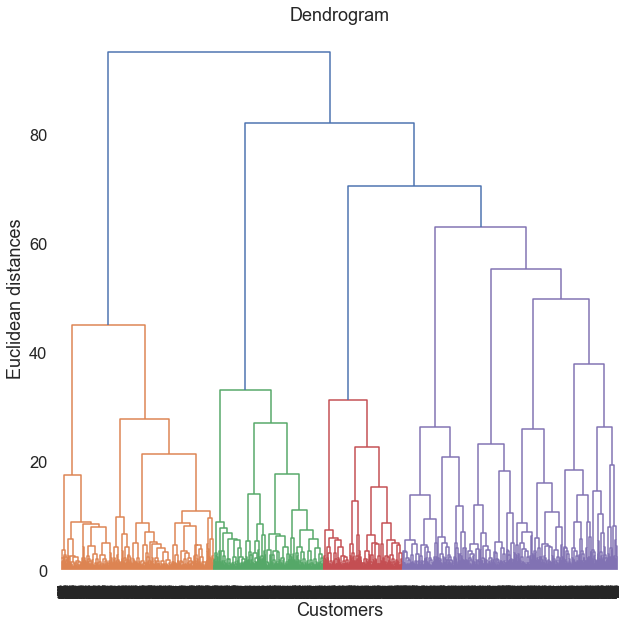

In [121]:
plt.figure(figsize=(10,10))
dendrogram = shc.dendrogram(shc.linkage(df_ml_data_customer_rfm_value_std, method = 'ward'))
plt.title('Dendrogram')
plt.xlabel('Customers')
plt.ylabel('Euclidean distances')
plt.show()

Le choix du nombre de clusters peut être 5, 6, ou 7. Nous allons tester les 3 valeurs.
La valeur 7 permet d'atteindre le meilleur score de silhouette.

### 8.3.2 Calcul du clustering hiérarchique avec K = 7

In [128]:
labels_clust_hierac = clustering_hierarchical(df_ml_data_customer_rfm_value_std, 7)

Coefficient silhouette: 0.410


In [129]:
labels_clust_hierac

array([5, 5, 0, ..., 6, 6, 1], dtype=int64)

#### 8.3.2.1 Visualisation T-SNE 2D avec les clusters du clustering hiérarchique

In [130]:
# Préparation des données pour affichage des points 
df_tsne_rfm_clhierac = pd.DataFrame()
df_tsne_rfm_clhierac['labels'] = labels_clust_hierac
df_tsne_rfm_clhierac['tsne-2d-axe 1'] = data_projected_rfm_2d[:,0]
df_tsne_rfm_clhierac['tsne-2d-axe 2'] = data_projected_rfm_2d[:,1]
df_tsne_rfm_clhierac

,labels,tsne-2d-axe 1,tsne-2d-axe 2
0,5,0.969539,-0.100485
1,5,8.192674,-0.471216
2,0,4.054979,6.007330
3,2,-9.099467,-6.137505
4,0,7.238705,5.565848
...,...,...,...
19739,0,3.835681,11.579696
19740,4,10.326876,-4.399666
19741,6,-4.091373,1.933107
19742,6,-0.542887,1.057434


In [131]:
# Nombre de clients par cluster
df_tsne_rfm_clhierac['labels'].value_counts()

0    5443
2    3868
3    2818
4    2273
1    1952
5    1696
6    1694
Name: labels, dtype: int64

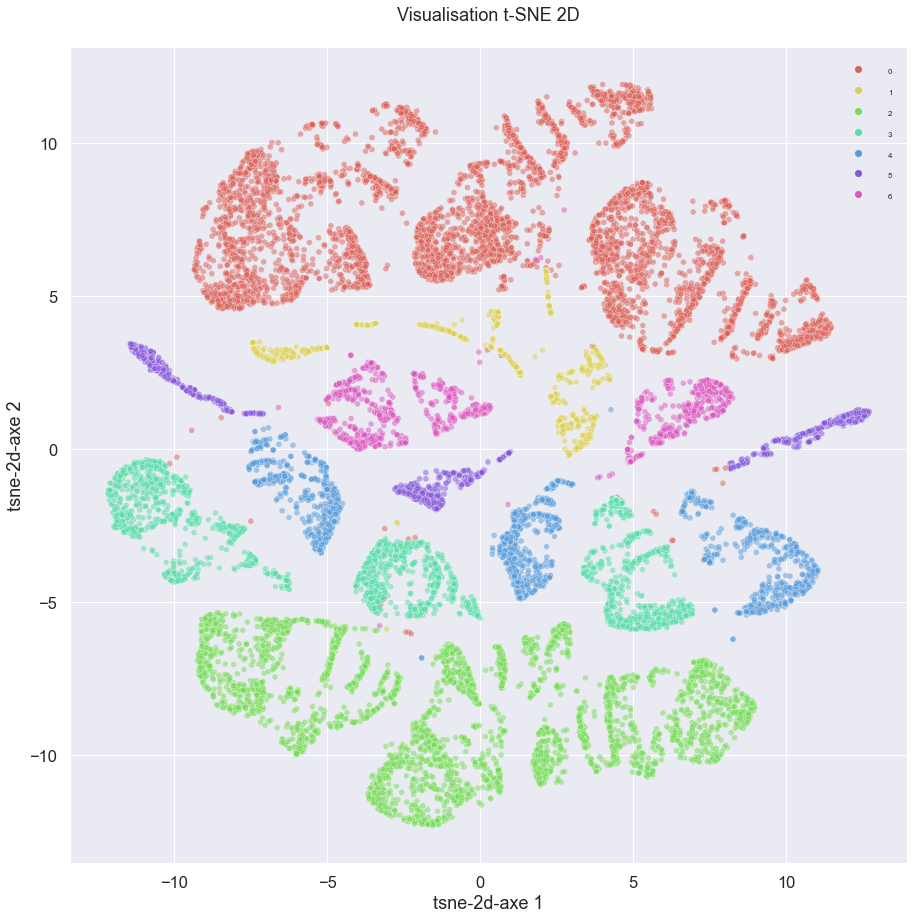

In [132]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_rfm_clhierac, 7)

La visualisation T-SNE 2D montre la présence clusters isolés pour les clusters 0 et 6. Nous allons le confirmer par une visualisation en 3D.

#### 8.3.2.2 Visualisation T-SNE 3D avec les clusters dbscan - Graphe intéractif

In [133]:
# Préparation des données pour affichage des points 
df_tsne_rfm_clhierac_3d = pd.DataFrame()
df_tsne_rfm_clhierac_3d['labels'] = labels_clust_hierac
df_tsne_rfm_clhierac_3d['tsne-3d-axe 1'] = data_projected_rfm_3d[:,0]
df_tsne_rfm_clhierac_3d['tsne-3d-axe 2'] = data_projected_rfm_3d[:,1]
df_tsne_rfm_clhierac_3d['tsne-3d-axe 3'] = data_projected_rfm_3d[:,2]
df_tsne_rfm_clhierac_3d

,labels,tsne-3d-axe 1,tsne-3d-axe 2,tsne-3d-axe 3
0,5,-2.622433,-5.711923,0.295667
1,5,4.213441,-3.439202,-0.290927
2,0,3.666024,4.469151,-2.162904
3,2,-5.496171,-4.333920,1.739062
4,0,5.349966,2.301671,0.901070
...,...,...,...,...
19739,0,0.357308,4.667121,4.780676
19740,4,4.894441,-3.859540,-3.833016
19741,6,-2.730766,0.154024,-0.452005
19742,6,-1.037844,2.129923,-2.323327


In [187]:
proj_grade_tsne_3d_interactif(df_tsne_rfm_clhierac_3d)

La visualisation T-SNE 3D confirme la présence de points isolés pour le clusters 0 et 6.

## 8.4 Détermination du meilleur algorithme de clustering non supervisé

Les différents algorithmes de clustering non supervisé sont évalués selon les critéres de qualité suivants:
- **Critères techniques:** tout d'abord, le coefficient de silhouette (plus il est proche de 1, plus la qualité de clustering est bonne), puis la distance inter-clusters. (**Critères prépondérants)**


- **Critères métiers:** plus subjectifs, comme l'homogénéité des différents clusters en termes de taille, le nombre de clusters, le facilité d'exploitation et de maintenance. 


### 8.4.1 Critère du facteur de forme - Coefficient de silhouette

Text(0.5, 0.98, 'Coefficient de silhouette par méthode')

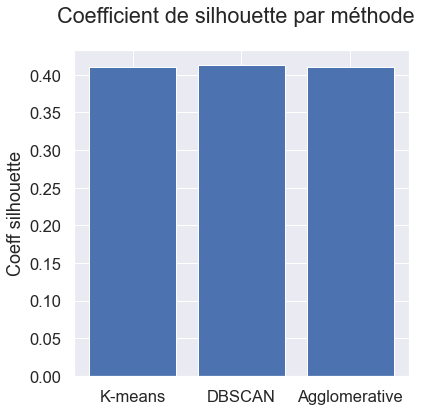

In [138]:
data = {'K-means': 0.4109, 'DBSCAN': 0.413, 'Agglomerative': 0.41}
names = list(data.keys())
values = list(data.values())

fig, ax = plt.subplots(figsize=(6, 6))
ax.bar(names, values)
ax.set_ylabel('Coeff silhouette')
fig.suptitle('Coefficient de silhouette par méthode')

Sur le critère du facteur de forme, le modèle **DBSCAN à 9 clusters est le meilleur algorithme de clustering non supervisé**, de très peu sur les 2 autres méthodes (autour de 0,41 sur le score de silhouette).

On peut dire que la valeur du coefficient de silhouette est moyenne, ce qui montre que la segmentation clientèle proposée ne montre pas des profils très marqués.

Le point ci-dessous montre le score de silhouette et les facteurs de forme par cluster pour le modèle k-means.

#### 8.4.1.2 Analyse du coefficient de silhouette pour le modèle K-means

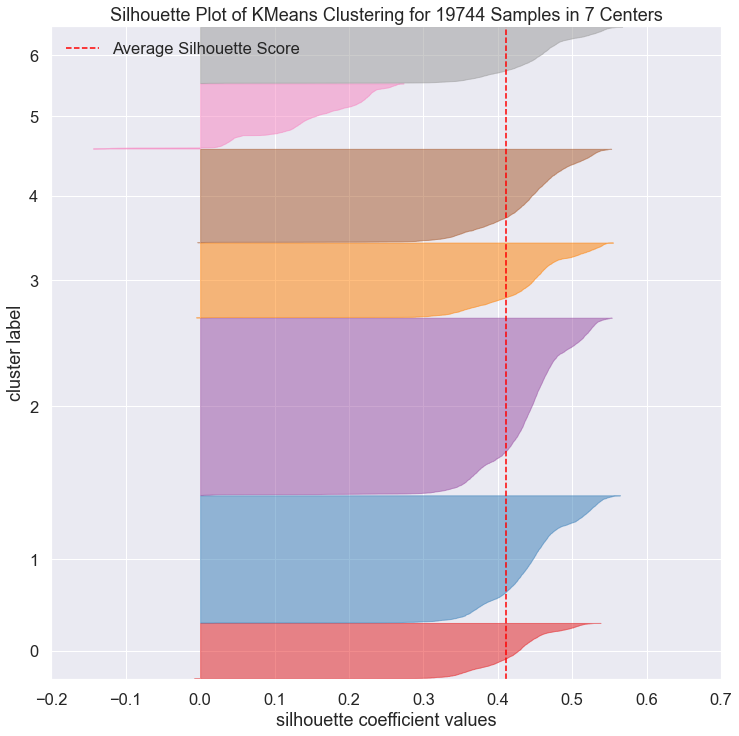

In [136]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(df_ml_data_customer_rfm_value_std,cluster_kmeans)

Le score de chaque échantillon est calculé en faisant la moyenne du coefficient de silhouette (différence entre la distance moyenne intra-cluster et la distance moyenne du cluster le plus proche pour chaque échantillon), normalisée par la valeur maximale. Cela nous donne un score entre -1 et 1, qui nous permet de déterminer si la séparation est efficace ou si les points sont assignés au mauvais cluster.

La valeur relativement moyenne du coefficient de silhouette (0.4109) indique que les clusters sont distincts, mais pas toujours de manière franche (possibilité de chevauchement).

On voit de plus que les clusters semblent assez bien répartis (les surfaces des différents clusters ne sont pas les mêmes sur le graphe des facteurs de forme).

On note aussi la présence d'erreurs sur le cluster 5 (score inférieur à la moyenne du coefficient de silhouette).

### 8.4.2 Séparation des clusters

La visualisation T-SNE 3D montre que les modèles de clustering hiérarchique à 7 clusters et DBSCAN à 9 clusters présente du bruit entre clusters.

Et enfin, le modèle k-means présente un non-chevauchement des clusters (voir calcul de la distance inter-clusters ci-dessous).

Compte tenu des scores équivalents obtenus par les différentes méthodes sur le coefficient de silhouette, **le meilleur modèle reste le k-means**.

#### 8.4.2.1 Calcul de la distance inter-cluster pour le modèle K-means

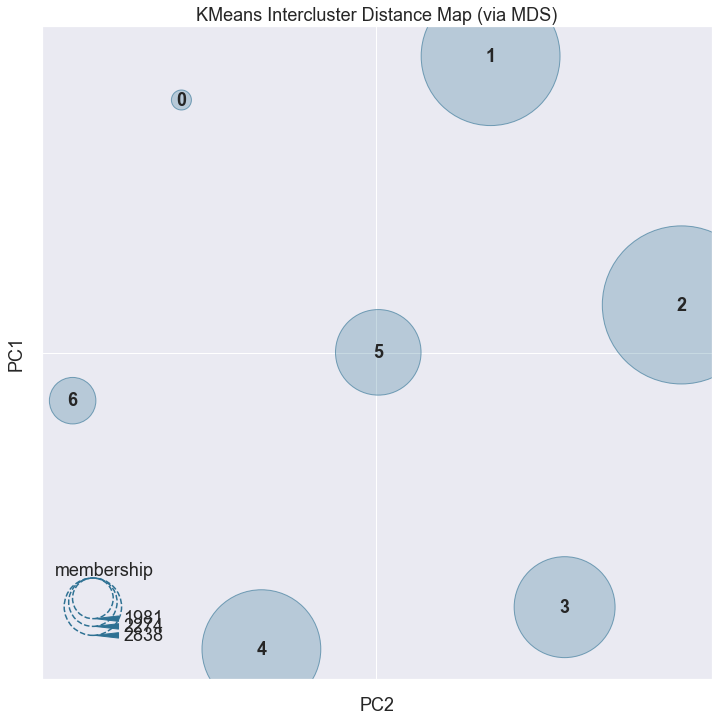

In [186]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_distance_intercluster_kmeans(df_ml_data_customer_rfm_value_std,cluster_kmeans)

Sur cette projection en 2D, on remarque que les différents clusters sont bien séparés sur les 2 premières composantes principales. Le clustering semble donc performant.

### 8.4.3 Homogénéité dans la taille des clusters

**Les modèles de k-means et de clustering hiérarchique à 7 clusters présente à peu près la même homogénéité sur la taille des clusters**.

Le modèle DBSCAN à 9 clusters est écarté, car la gestion de 9 clusters est difficile et qu'il contient des petits clusters.

|Modèle|Taille cluster 0|Taille cluster 1|Taille cluster 2|Taille cluster 3| Taille cluster 4|Taille cluster 5|Taille cluster 6|Taille cluster 7| Taille cluster 8|
|-------|-----------|-----------|-------------|-----------|------------|------------|--------------|-------------|--------------|
|K-means| 1688 | 3869 | 5387 | 2274 | 2838 | 1981 | 1707 |   |    |
|DBSCAN | 1679 | 5328 | 3834 | 2242 | 2790 | 168  | 1650 | 517 | 942 |
|Agglomerative clustering| 5443 | 1952 | 3868 | 2818 | 2273 | 1696 | 1694 |
 

### 8.4.4 Conclusion finale sur la méthode retenue

Compte tenu de la métrique du score de silhouette, **le modèle k-means à 7 clusters est retenu**.

Le modèle de clustering hiérarchique (agglomerative clustering) présente lui aussi 7 clusters avec des profils de clusters (taille et composition) identiques.

Mais, le modèle de clustering hiérarchique mobilise plus de ressources système pour entraîner le modèle, particulièrement sur des volumes de données importants.

## 8.5 Signification métier du clustering pour la méthode retenue (K-means)

In [151]:
# Ajout des labels de clusters k-means dans le dataset
df_ml_data_customer_rfm_value["kmeans_label"] = labels_kmeans
df_ml_data_customer_rfm_value

,nb_orders,mean_payment_sequential,mean_review_score,mean_payment_installments,mean_delivery_days,favorite_purchase_month,favorite_purchase_hour,books_cds_media,fashion_clothing_accessories,flowers_gifts,...,other,sport,technology,toys_baby,mean_nb_items,order_mean_delay,freight_ratio,mean_price_order,harvesine_distance,kmeans_label
0,1,1.0,1.0,3.0,16.0,2,11,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,2.0,32.0,0.09,382.00,108.557249,6
1,1,1.0,1.0,4.0,54.0,3,15,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,1.0,19.0,0.19,104.90,1522.737226,6
2,1,1.0,5.0,3.0,16.0,3,14,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,7.0,0.22,49.95,209.713834,2
3,1,1.0,5.0,1.0,4.0,1,22,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,1.0,83.0,0.21,28.90,209.713834,1
4,1,1.0,4.0,6.0,23.0,3,17,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,26.0,0.19,49.95,209.713834,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19739,1,1.0,1.0,1.0,10.0,2,21,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,51.0,0.17,179.00,209.713834,2
19740,1,1.0,5.0,3.0,7.0,3,17,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,24.0,0.18,70.00,493.836401,3
19741,1,1.0,4.0,2.0,14.0,1,11,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,67.0,0.06,213.90,209.713834,0
19742,1,1.0,5.0,2.0,17.0,2,12,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,48.0,0.10,199.00,669.215559,0


In [152]:
# Regroupement des individus par cluster k-means pour analyser les moyennes
kmeans_clusters_means = df_ml_data_customer_rfm_value.groupby("kmeans_label").mean().reset_index()
kmeans_clusters_means

,kmeans_label,nb_orders,mean_payment_sequential,mean_review_score,mean_payment_installments,mean_delivery_days,favorite_purchase_month,favorite_purchase_hour,books_cds_media,fashion_clothing_accessories,...,home_furniture,other,sport,technology,toys_baby,mean_nb_items,order_mean_delay,freight_ratio,mean_price_order,harvesine_distance
0,0,1.006517,1.045024,3.937796,3.658472,15.851797,2.021327,14.720379,0.000000,0.000296,...,0.000494,0.001185,0.000296,0.000592,0.000197,1.053318,43.864336,0.148531,181.628472,489.518936
1,1,1.008529,1.025459,3.863175,1.966184,16.035739,1.986818,14.605583,0.000000,0.000215,...,0.000181,0.000129,0.000065,0.999108,0.000000,1.130331,44.830490,0.263456,93.281297,456.312151
2,2,1.015036,1.049935,3.872888,3.125450,16.093579,1.990161,14.838500,0.000093,0.000278,...,0.996285,0.001253,0.000234,0.001067,0.000170,1.216329,44.558146,0.215764,119.442920,397.343010
3,3,1.008355,1.030123,4.021255,2.967312,14.965333,2.008355,14.638083,0.000000,0.000000,...,0.000660,0.000806,0.000440,0.000880,0.000110,1.094327,44.583113,0.192238,124.970185,447.713761
4,4,1.006695,1.044750,3.987139,2.717054,15.304998,1.952431,14.746653,0.000529,0.000352,...,0.001292,0.996212,0.000352,0.000558,0.000000,1.115751,46.284355,0.193034,133.798259,440.428142
5,5,1.020192,1.037860,4.013369,2.559297,14.436185,1.986371,14.726401,0.083291,0.298788,...,0.004543,0.001531,0.000202,0.000505,0.505469,1.077907,44.830725,0.213766,106.250959,437.233230
6,6,1.011716,1.031634,3.908319,2.344659,15.475786,2.044523,14.765671,0.000000,0.000000,...,0.000879,0.001465,0.996778,0.000000,0.000000,1.126538,43.078207,0.186303,122.153269,410.989619


In [153]:
# Standardisation des données
scaler = MinMaxScaler()
data_scaled = scaler.fit_transform(df_ml_data_customer_rfm_value)
data_scaled = pd.DataFrame(data_scaled, index=df_ml_data_customer_rfm_value.index, 
                           columns=df_ml_data_customer_rfm_value.columns)
data_scaled["kmeans_label"] = labels_kmeans
data_scaled_clusters = data_scaled.groupby("kmeans_label").mean()
data_scaled_clusters

,nb_orders,mean_payment_sequential,mean_review_score,mean_payment_installments,mean_delivery_days,favorite_purchase_month,favorite_purchase_hour,books_cds_media,fashion_clothing_accessories,flowers_gifts,...,home_furniture,other,sport,technology,toys_baby,mean_nb_items,order_mean_delay,freight_ratio,mean_price_order,harvesine_distance
kmeans_label,,,,,,,,,,,,,,,,,,,,,
0,0.001629,0.003216,0.734449,0.115586,0.136255,0.510664,0.640016,0.000000,0.000296,0.996347,...,0.000494,0.001185,0.000296,0.000592,0.000197,0.004101,0.484518,0.173164,0.181173,0.192523
1,0.002132,0.001818,0.715794,0.042008,0.137943,0.493409,0.635025,0.000000,0.000215,0.000302,...,0.000181,0.000129,0.000065,0.999108,0.000000,0.010025,0.495313,0.316820,0.091572,0.175742
2,0.003759,0.003567,0.718222,0.092411,0.138473,0.495081,0.645152,0.000093,0.000278,0.000495,...,0.996285,0.001253,0.000234,0.001067,0.000170,0.016641,0.492270,0.257205,0.118105,0.145941
3,0.002089,0.002152,0.755314,0.085535,0.128122,0.504178,0.636438,0.000000,0.000000,0.000000,...,0.000660,0.000806,0.000440,0.000880,0.000110,0.007256,0.492549,0.227798,0.123711,0.171397
4,0.001674,0.003196,0.746785,0.074655,0.131239,0.476216,0.641159,0.000529,0.000352,0.000176,...,0.001292,0.996212,0.000352,0.000558,0.000000,0.008904,0.511557,0.228792,0.132664,0.167715
5,0.005048,0.002704,0.753342,0.067796,0.123268,0.493185,0.640278,0.083291,0.298788,0.001430,...,0.004543,0.001531,0.000202,0.000505,0.505469,0.005993,0.495315,0.254707,0.104726,0.166100
6,0.002929,0.002260,0.727080,0.058463,0.132805,0.522261,0.641986,0.000000,0.000000,0.000000,...,0.000879,0.001465,0.996778,0.000000,0.000000,0.009734,0.475734,0.220379,0.120854,0.152838


In [154]:
# Appel de la fonction pour l'affichage du graphe des composantes métier des clusters
plot_radars(data=data_scaled_clusters,
            group="kmeans_label")

La segmentation clientèle ne met pas en exergue des profils très marqués sur les comportement des clients et le poids des catégories de produit est prépondérante sur toutes les autres caractéristiques.

**Le cluster 0 comprend 1688 clients avec les caractéristiques distinctives suivantes:**
- clients achetant principalement des fleurs et des cadeaux.
- clients qui dépensent le plus (plus de 181 en moyenne dans l'unité de compte du pays).
- clients qui présentent un ratio de frais de livraison par rapport à leur dépense totale le plus faible (14%).

**Le cluster 1 comprend 3869 clients avec les caractéristiques distinctives suivantes:**
- clients achetant principalement de la technologie.
- clients qui dépensent le moins (93 en moyenne dans l'unité de compte du pays).
- clients qui présentent un ratio de frais de livraison par rapport à leur dépense totale le plus élevé (26%).


**Le cluster 2 comprend 5387 clients avec les caractéristiques distinctives suivantes:**
- clients achetant principalement des fournitures pour la maison.
- clients qui présentent une dépense moyenne.
- clients qui présentent un ratio de frais de livraison par rapport à leur dépense totale moyen (20%)


**Le cluster 3 comprend 2274 clients avec les caractéristiques distinctives suivantes:**
- clients achetant principalement des produits de santé et beauté.
- clients qui présentent une dépense moyenne.
- clients qui présentent un ratio de frais de livraison par rapport à leur dépense totale moyen (20%)


**Le cluster 4 comprend 2838 clients avec les caractéristiques distinctives suivantes:**
- clients achetant principalement plusieurs catégories de produit (catégorie 'Other').
- clients qui présentent une dépense moyenne.
- clients qui présentent un ratio de frais de livraison par rapport à leur dépense totale moyen (20%)


**Le cluster 5 comprend 1981 clients avec les caractéristiques distinctives suivantes:**
- clients achetant principalement les 3 catégories de produit suivantes:
     - jouets et produits pour bébés
     - fleurs et cadeaux
     - épicerie et boissons
- clients qui présentent une dépense moyenne.
- clients qui présentent un ratio de frais de livraison par rapport à leur dépense totale moyen (20%)


**Le cluster 6 comprend 1707 clients avec les caractéristiques distinctives suivantes:**
- clients achetant principalement des articles de sport.
- clients qui présentent une dépense moyenne.
- clients qui présentent un ratio de frais de livraison par rapport à leur dépense totale moyen (20%)



**Caractéristiques communes aux client des 3 clusters:**
- ils achètent en moyenne tous les 44 à 46 jours, soit 2 fois en 3 mois. Client peu actifs.
- ils achètent un peu plus d'un article sur la période.
- ils achètent principalement, à une heure favorite, entre 14h et 15h.
- ils ont tous achetés autour du mois de février.
- ils attendent en moyenne entre 14 et 16 jours pour la livraion de leurs produits. 
- ils achètent leurs produits avec 2 ou 3 échéances de paiements (achats à crédit).
- les avis client sont autour de 4, c'est-à-dire que les clients sont satisfaits.
- ils utilisent en moyenne un seul type de paiement (carte de crédit).
- ils font moins de 2 commandes dans la période.

Donc,au final:
- **cluster 0**: clients mono-produit achetant principalement des fleurs et des cadeaux, clients dépensiers et qui privilégient des frais de livraison réduits. Meilleurs clients en termes de dépenses d'achat.
- **cluster 1**: clients mono-produit achetant principalement des produits technologiques, client peu dépensiers et qui acceptent des frais de livraions plus élevés.
- **cluster 2**: clients peu actifs en termes de fréquence et de dépenses d'achat. Clients mono-produit achetant principalement des fournitures pour la maison.
- **cluster 3**: clients peu actifs en termes de fréquence et de dépenses d'achat. Clients mono-produit achetant principalement des produits de santé et beauté.
- **cluster 4**: clients peu actifs en termes de fréquence et de dépenses d'achat. Clients multi-produit achetant plusieurs catégories de produits. Clients à surveiller car ils n'achètent pas les produits les plus courants sur le site e-commerce.
- **cluster 5**:  clients peu actifs en termes de fréquence et de dépenses d'achat. Clients multi-produit achetant 3 catégories de produits. Clients prometteurs car ils achètent des produits de grande consommation sur le site e-commerce.
- **cluster 6**:  clients peu actifs en termes de fréquence et de dépenses d'achat. Clients mono-produit achetant principalement des articles de sport.


## 8.6 Stabilité temporelle de la segmentation 

Dans le but d'établir un contrat de maintenance de la solution retenue pour la segmentation client, nous devons tester sa stabilité de la qualité du clustering au fil du temps, en évaluant le score de silhouette pa rapport à une période initiale.

Ainsi, nous évaluerons le score de silhouette sur une période initiale de 3 mois du 01/01/2018 au 31/03/2018.
Puis, nous évaluerons ce même score de silhouette sur 3 mois glissants, par pas de 1 mois sur 5 mois.

Nous considérerons que le clustering devra être relancé lorsque le score de silhouette perd entre 5% et 7 % de sa valeur par rapport au jeu de données initial.

### 8.6.1 Calcul du score de silhouette sur 3 mois glissants par pas de 1 mois sur 5 mois

In [170]:
silhouette_scoring = stabilite_tempo_kmeans(7, df_ml_data_customer_rfm_value, labels_kmeans, './Input/', 
                       True, '01/01/18 00:00:00', 3)

Création dataset pour pas: 1 - décalage de 1 mois par rapport à la période initiale
--------------------------------------------------------------------------
Dataset creation in progress ...
2018-02-01 00:00:00
2018-05-01 00:00:00
Liste des lignes dupliquées pour chaque colonne de la dataframe :
Empty DataFrame
Columns: [order_id, order_item_id, product_id, price, freight_value, customer_id, order_status, order_purchase_timestamp, order_delivered_customer_date, order_purchase_year, order_purchase_month, order_purchase_dayofweek, order_purchase_hour, order_purchase_day, order_purchase_mon, nb_payment_sequential, sum_payment_installments, review_score, customer_unique_id, customer_zip_code_prefix, customer_city, customer_state, product_category_name]
Index: []

[0 rows x 23 columns]
------ Imputation valeur 1 si présence valeurs NaN pour variable "nb_payment_sequential" ------
------ Dataset suite imputation valeur 1 si présence valeurs NaN pour variable "nb_payment_sequential" ------
P

Date dernier achat, tous clients confondus: 2018-07-31 23:54:20
----- Remplacement des valeurs 0 par la valeur 1 pour la variable "mean_payment_installments" ------
------ Dataset suite traitement outliers pour variable "mean_payment_installments" ------
Proportion de NaN : 0.0 %, Taille du jeu de données : (18765, 30)

nombre de lignes à supprimer: 239
Proportion de NaN : 0.0 %, Taille du jeu de données : (18526, 30)

Execution time for dataset creation and feature engineering : 169.26s
Dimensions du dataset après filtre: (18526, 27)

Pour K (nbre clusters) = 7 le score moyen de silhouette est de : 0.33383539313006005
Création dataset pour pas: 5 - décalage de 5 mois par rapport à la période initiale
--------------------------------------------------------------------------
Dataset creation in progress ...
2018-06-01 00:00:00
2018-09-01 00:00:00
Liste des lignes dupliquées pour chaque colonne de la dataframe :
Empty DataFrame
Columns: [order_id, order_item_id, product_id, price, freig

In [171]:
df_silhouette_score = pd.DataFrame(silhouette_scoring, columns = ['periode', 'score silhouette'])
df_silhouette_score

,periode,score silhouette
0,0,0.410900
1,1,0.411905
2,2,0.415724
3,3,0.422320
4,4,0.333835
5,5,0.427661


### 8.6.2 Affichage des scores de silhoutte sur 3 mois glissants par pas de 1 mois sur 5 mois

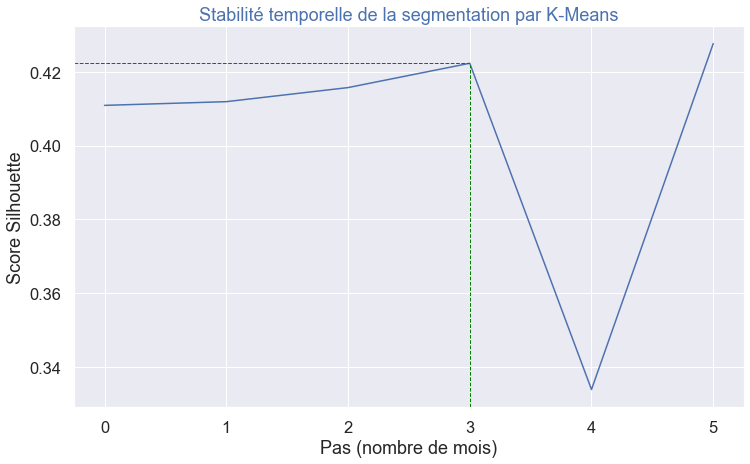

In [191]:
# Affichage de stabilité temporelle du score de silhouette sur 5 mois glissants
fig = plt.figure(figsize=(12,7))
sns.lineplot(data=df_silhouette_score, x="periode", y="score silhouette")
plt.axhline(y=df_silhouette_score.iloc[3][1], linestyle="--", 
            color="green",
            xmax=0.59,
            linewidth=1)
plt.axvline(x=df_silhouette_score.iloc[3][0], linestyle="--", 
            color="green",
            ymax=1.32-df_silhouette_score.iloc[3][1],
            linewidth=1)
plt.xlabel("Pas (nombre de mois)")
plt.ylabel("Score Silhouette")
plt.title("Stabilité temporelle de la segmentation par K-Means",
          fontsize=18,
          color="b")
plt.show()


Il apparaît que le contrat de maintenance doit permettre de mettre à jour les clusters après le 4ème mois: en effet, après le 4ème mois, le score de silhouette chute de 19%.

Le pas 3 correspond à la période avril-mai-juin 2018.
Le pas 4 correspond à la période mai-juin-juillet 2018. Au pas 4, à partir du moi de mai, le score de silhouette se dégrade fortement.

**Par conséquent, on doit établir un contrat de maintenance tous les 4 mois.**